# 플랜트닥터(PlantDoctor) AI 모델 구축 보고서

## 1. 프로젝트 배경 및 필요성

### 도시 농업 및 홈가드닝 트렌드
- COVID-19 이후 가정에서의 식물 재배 및 도시 농업에 대한 관심 급증
- 아파트 베란다, 실내 공간, 옥상 정원 등을 활용한 도시 원예 활동 확대
- 자급자족 및 친환경 생활에 대한 관심 증가로 도시 농부 증가 추세
- 홈가드닝 초보자들의 식물 관리 지식 부족으로 인한 어려움 존재

### 기술적 배경
- 스마트폰 보급 확대 및 AI 기술 발전으로 모바일 식물 질병 진단 애플리케이션 개발 가능성 증가
- 일반인도 쉽게 식물 질병을 진단하고 관리할 수 있는 접근성 있는 솔루션 필요
- 전문가 상담이 어려운 도시 환경에서 AI 기반 대안 솔루션의 중요성 부각

이러한 배경에서 도시 원예사와 홈가드닝 애호가들을 위한, 머신러닝 기반 모바일 식물 질병 진단 시스템인 '플랜트닥터' 앱을 개발하고자 함.

## 2. 데이터셋

- **데이터셋**: Plant Village 데이터셋
- **분류 클래스**: 38가지 식물 상태 (14종 식물의 건강 상태 및 다양한 질병)
- **대상 식물**: 사과, 블루베리, 체리, 옥수수, 포도, 오렌지, 복숭아, 피망, 감자, 라즈베리, 콩, 호박, 딸기, 토마토
- **입력 이미지 크기**: 160x160x3 (RGB)

## 3. 초기 모델 개발 (기본 CNN 모델)

### 3.1 모델 아키텍처

```python
model = Sequential([
    Conv2D(filters=16, kernel_size=3, padding='same', activation='relu', input_shape=(160, 160, 3)),
    MaxPooling2D(),
    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=38, activation='softmax')
])
```

### 3.2 모델 규모
- **모델 규모**:
    - 총 파라미터: 13,150,790
    - 훈련 가능 파라미터: 13,150,790
    - 입력 이미지 크기: 160x160x3

```
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
=================================================================
conv2d (Conv2D)              (None, 160, 160, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 80, 80, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 80, 80, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 40, 40, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 40, 40, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 20, 20, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 25600)             0         
_________________________________________________________________
dense (Dense)                (None, 512)               13107712  
_________________________________________________________________
dense_1 (Dense)              (None, 38)                19494     
=================================================================
Total params: 13,150,790
Trainable params: 13,150,790
Non-trainable params: 0
_________________________________________________________________
```
- **1차 기본 모델**:
    - 3개의 컨볼루션 레이어와 풀링 레이어
    - 1개의 Flatten 레이어
    - 2개의 Dense 레이어 (512 유닛, 38 유닛)
    - 파라미터 수: 약 1,300만 개

### 3.3 학습 결과

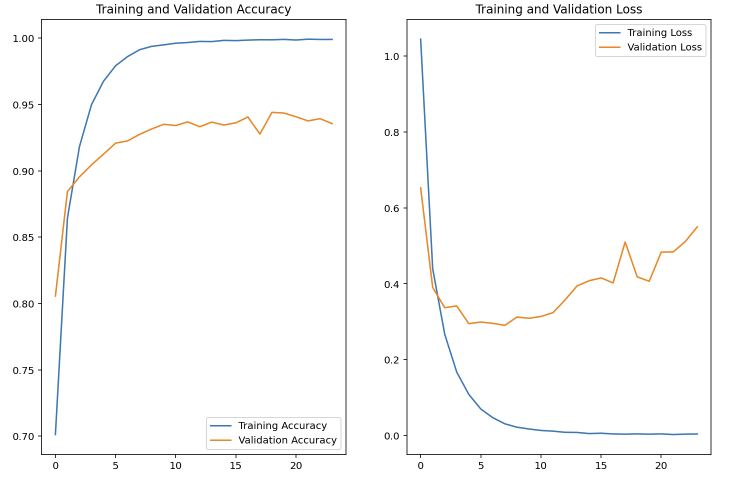

학습 결과는 다음과 같은 특징을 보임:

- **정확도 그래프 분석**:
  - 학습 정확도: 약 22 에포크에서 100%에 근접
  - 검증 정확도: 최대 약 94%에 도달 후 등락
  - 학습과 검증 정확도 간 간격이 약 6% 발생 (과적합 징후)

- **손실 함수 그래프 분석**:
  - 학습 손실: 지속적으로 감소하여 거의 0에 수렴
  - 검증 손실: 초기에 감소 후 에포크 10 이후 다시 증가 경향 (명확한 과적합 징후)
  - 검증 손실이 0.3~0.6 사이에서 변동

## 4. 전이학습 모델 개발 (VGG16 기반)

### 4.1 모델 아키텍처

```python
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(160, 160, 3))
global_average_layer = GlobalAveragePooling2D()
base_model.trainable = False  # 기본 모델 동결

model = Sequential([
    base_model,
    global_average_layer,
    Dense(units=512, activation='relu'),
    Dense(units=38, activation='softmax')
])
```

### 4.2 모델 규모

- **모델 규모**:
    - 총 파라미터: 14,996,838
    - 훈련 가능 파라미터: 282,150 (상단 레이어만 훈련)
    - 동결된 파라미터: 14,714,688 (VGG16 가중치)
    - 출력: 38개 클래스 분류

```
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
=================================================================
vgg16 (Functional)           (None, 5, 5, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 512)               262656    
_________________________________________________________________
dense_3 (Dense)              (None, 38)                19494     
=================================================================
Total params: 14,996,838
Trainable params: 282,150
Non-trainable params: 14,714,688
_________________________________________________________________
```

- **전이학습 모델** :
    - VGG16 기본 모델 (동결된 파라미터)
    - 글로벌 평균 풀링 레이어
    - 2개의 Dense 레이어 (512 유닛, 38 유닛)
    - 훈련 가능 파라미터: 약 28만 개
    - 총 파라미터: 약 1,500만 개
    

### 4.3 학습 결과

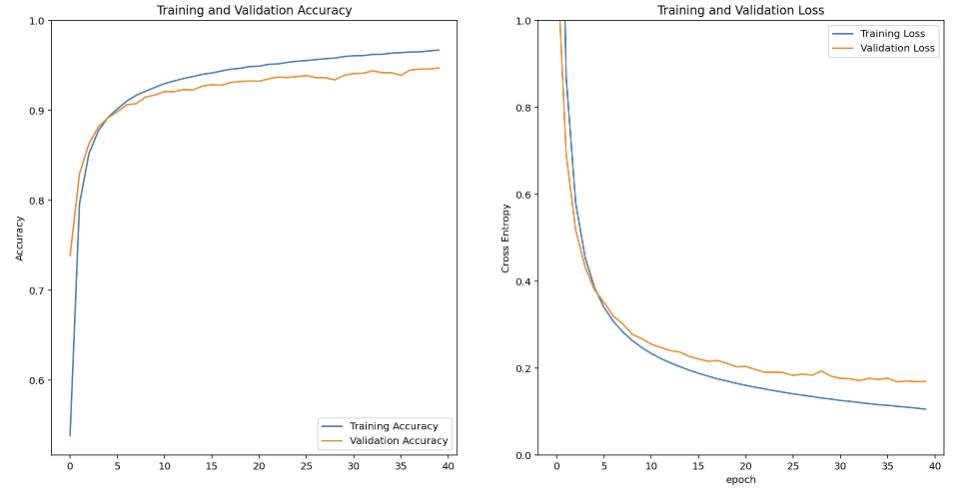

학습 결과는 다음과 같은 특징을 보임:

- **정확도 그래프 분석**:
  - 학습 정확도: 완만한 상승 곡선으로 약 40 에포크에서 약 95% 달성
  - 검증 정확도: 안정적인 상승 곡선으로 약 92%까지 도달
  - 학습과 검증 정확도 간 간격이 약 3%로 감소 (과적합 완화)

- **손실 함수 그래프 분석**:
  - 학습 손실: 지속적으로 감소하여 약 0.1 수준으로 수렴
  - 검증 손실: 학습 손실과 유사한 패턴으로 감소하여 약 0.18 수준으로 수렴
  - 학습과 검증 손실 간 간격이 유지되나 크지 않음


## 5. 모델 성능 비교 및 평가

### 5.1 기본 CNN 모델 vs 전이학습 모델

| 평가 지표 | 기본 CNN 모델 | 전이학습 모델 (VGG16) |
|---|---|---|
| 최대 검증 정확도 | ~94% | ~92% |
| 과적합 정도 | 심함 (검증 손실 증가) | 낮음 (검증 손실 안정) |
| 파라미터 수 | 13,150,790 | 14,996,838 |
| 훈련 가능 파라미터 | 13,150,790 | 282,150 |
| 모델 안정성 | 낮음 (검증 지표 변동) | 높음 (안정적 학습 곡선) |

### 5.2 모델 평가 및 분석

1. **정확도 측면**:
   - 기본 CNN 모델이 전이학습 모델보다 약간 높은 최대 검증 정확도를 보임
   - 그러나 전이학습 모델은 더 안정적인 학습 곡선 제공

2. **과적합 측면**:
   - 기본 CNN 모델: 뚜렷한 과적합 징후 (검증 손실 증가)
   - 전이학습 모델: 과적합 현상이 현저히 감소

3. **효율성 측면**:
   - 전이학습 모델: 훈련 가능 파라미터 약 28만 개로 기본 모델의 2.1% 수준
   - 메모리와 훈련 시간 측면에서 더 효율적

4. **일반화 능력**:
   - 전이학습 모델이 학습과 검증 지표 간 간격이 좁아 실제 데이터에 대한 일반화 능력이 우수할 것으로 예상

## 6. 결론 및 제언

### 6.1 결론

1. 전이학습 모델은 정확도가 약간 낮더라도 과적합이 적고 안정적인 성능을 보이므로 실제 애플리케이션에 더 적합함

2. VGG16 기반 전이학습 방식은 훈련 가능 파라미터를 크게 줄이면서도 준수한 성능을 유지함

3. 모바일 애플리케이션 배포를 고려할 때, 전이학습 모델이 더 효율적인 추론 성능을 제공할 것으로 예상

### 6.2 향후 개선 방향

1. **모델 경량화**:
   - MobileNet, EfficientNet 등 더 가벼운 모델로 전이학습 시도
   - 모델 양자화를 통한 추론 속도 개선
   - 스마트폰에서의 실시간 진단을 위한 최적화

2. **데이터 전처리 및 개선**:
   - **데이터셋 불균형 문제 해결**: 클래스 간 데이터 수 불균형이 심각하여 과대표현/과소표현된 클래스에 대한 성능 편차 발생. 언더샘플링, 오버샘플링, 가중치 조정 등의 기법 적용 필요
   - **현실 환경 대응력 향상**: 현재 데이터셋의 이미지가 너무 잘 정제되어 있어 실제 일반인이 촬영한 다양한 조명, 각도, 배경의 이미지에 대응하지 못함. 다양한 증강 기법 적용 필요
   - 실내 조명 환경, 베란다 환경 등 도시 환경에서 촬영된 이미지 추가 확보
   - 아파트 베란다, 실내 화분 등 도시 원예 환경에 특화된 데이터 확보

3. **아키텍처 개선**:
   - 2단계 분류 시스템 도입 (식물 종류 식별 → 질병 진단)
   - 앙상블 기법을 통한 정확도 향상
   - 시간에 따른 식물 변화를 추적할 수 있는 시계열 분석 모델 추가
   - **비식물 이미지 필터링**: 현재 모델은 사람이나 기타 관련 없는 사진을 넣었을 때 제대로 인식하지 못함. 식물/비식물 이미지를 구분하는 전처리 분류기 추가 필요
   - **예외 처리 강화**: 모바일 경량화 모델 재훈련 시 적절한 예외 처리 및 신뢰도 임계값 설정 필요

4. **사용자 경험 최적화**:
   - 진단 결과에 신뢰도 점수를 함께 제공하여 사용자에게 참고 정보 제공
   - 낮은 신뢰도 예측에 대한 대체 진단 옵션 제시
   - 지역별 기후 데이터와 연동하여 맞춤형 관리 조언 제공
   - 진단 후 식물 상태 개선을 위한 단계별 가이드 추가



# 세부 실험 내역

## 0. 기본 환경설정

In [1]:
#패키지 외 경고 메시지 무시

import warnings
warnings.filterwarnings("ignore")

print("완료!")

완료!


In [2]:
#텐서플로우 로드 및 버전 확인

import os
import tensorflow as tf
print(tf.__version__)

2.6.0


In [3]:
#텐서플로우 데이터셋 로드

import tensorflow_datasets as tfds

tfds.__version__

'4.4.0'

## 데이터셋 로드 및 데이터 분할

In [36]:
#훈련 8/검증1/테스트 1 데이터셋 분리

(raw_train, raw_validation, raw_test), metadata = tfds.load(
    name='plant_village',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    data_dir='~/aiffel/plant_village/dataset',
    download=False, #최초 실행 시 True로 설정하였고, 이후에 재실행하면서 False로 변경
    with_info=True,
    as_supervised=True,
)

In [37]:
print("Train 개수:", len(list(raw_train)))
print("Validation 개수:", len(list(raw_validation)))
print("Test 개수:", len(list(raw_test)))

Train 개수: 43442
Validation 개수: 5431
Test 개수: 5430


## EDA

In [6]:
#클래스 정보 확인 

class_names = metadata.features['label'].names
print("클래스 개수:", len(class_names))
print("클래스 이름 목록:", class_names)

클래스 개수: 38
클래스 이름 목록: ['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry___healthy', 'Cherry___Powdery_mildew', 'Corn___Cercospora_leaf_spot Gray_leaf_spot', 'Corn___Common_rust', 'Corn___healthy', 'Corn___Northern_Leaf_Blight', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___healthy', 'Potato___Late_blight', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___healthy', 'Strawberry___Leaf_scorch', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___healthy', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot', 'Tomato___Tomato_mos

In [7]:
#시각화에 필요한 라이브러리 임포트

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

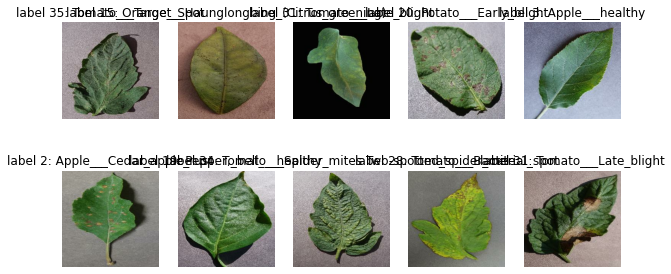

In [8]:
plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(raw_train.take(10)):  # 10개의 데이터를 가져 옵니다.
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [9]:
# 모든 클래스의 매핑 정보 저장

label_mapping = {}
for i in range(len(metadata.features['label'].names)):
    label_mapping[i] = get_label_name(i)

In [11]:
# 매핑 정보 출력 및 저장

print("클래스 매핑 정보:")
for idx, name in label_mapping.items():
    print(f"{idx}: {name}")

클래스 매핑 정보:
0: Apple___Apple_scab
1: Apple___Black_rot
2: Apple___Cedar_apple_rust
3: Apple___healthy
4: Blueberry___healthy
5: Cherry___healthy
6: Cherry___Powdery_mildew
7: Corn___Cercospora_leaf_spot Gray_leaf_spot
8: Corn___Common_rust
9: Corn___healthy
10: Corn___Northern_Leaf_Blight
11: Grape___Black_rot
12: Grape___Esca_(Black_Measles)
13: Grape___healthy
14: Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
15: Orange___Haunglongbing_(Citrus_greening)
16: Peach___Bacterial_spot
17: Peach___healthy
18: Pepper,_bell___Bacterial_spot
19: Pepper,_bell___healthy
20: Potato___Early_blight
21: Potato___healthy
22: Potato___Late_blight
23: Raspberry___healthy
24: Soybean___healthy
25: Squash___Powdery_mildew
26: Strawberry___healthy
27: Strawberry___Leaf_scorch
28: Tomato___Bacterial_spot
29: Tomato___Early_blight
30: Tomato___healthy
31: Tomato___Late_blight
32: Tomato___Leaf_Mold
33: Tomato___Septoria_leaf_spot
34: Tomato___Spider_mites Two-spotted_spider_mite
35: Tomato___Target_Spot
36: To

In [12]:
#클래스별 분포 확인

import collections

label_counts = collections.Counter()

for _, label in raw_train:
    label_counts[int(label.numpy())] += 1

# 라벨 이름으로 변환하여 보기
for i, count in label_counts.items():
    print(f"{class_names[i]}: {count}개")

Tomato___Target_Spot: 1124개
Orange___Haunglongbing_(Citrus_greening): 4399개
Tomato___Late_blight: 1535개
Potato___Early_blight: 792개
Apple___healthy: 1306개
Apple___Cedar_apple_rust: 221개
Pepper,_bell___healthy: 1173개
Tomato___Spider_mites Two-spotted_spider_mite: 1360개
Tomato___Bacterial_spot: 1732개
Squash___Powdery_mildew: 1466개
Tomato___healthy: 1261개
Cherry___Powdery_mildew: 851개
Tomato___Tomato_mosaic_virus: 303개
Tomato___Tomato_Yellow_Leaf_Curl_Virus: 4252개
Peach___Bacterial_spot: 1838개
Strawberry___Leaf_scorch: 923개
Apple___Apple_scab: 501개
Soybean___healthy: 4043개
Corn___healthy: 939개
Blueberry___healthy: 1210개
Apple___Black_rot: 467개
Grape___Black_rot: 956개
Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 881개
Pepper,_bell___Bacterial_spot: 800개
Corn___Common_rust: 953개
Tomato___Septoria_leaf_spot: 1409개
Tomato___Early_blight: 807개
Tomato___Leaf_Mold: 758개
Grape___Esca_(Black_Measles): 1111개
Corn___Northern_Leaf_Blight: 788개
Potato___Late_blight: 801개
Raspberry___healthy: 302개
Cherry

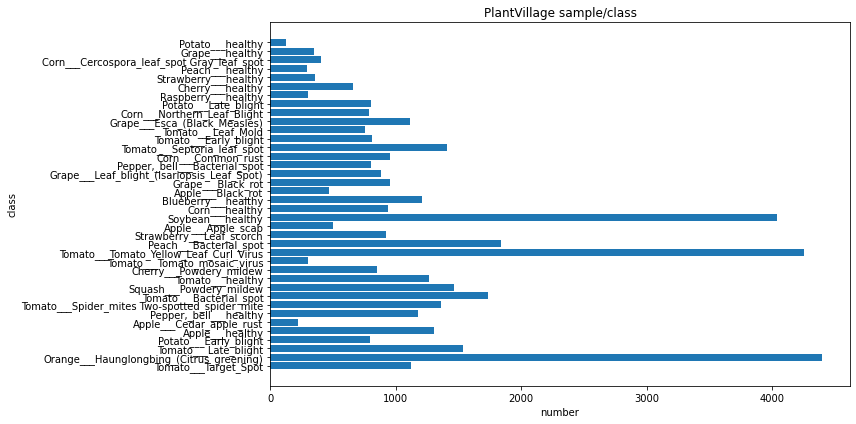

In [13]:
# 클래스 이름과 각 개수 정렬
labels = [class_names[i] for i in label_counts.keys()]
counts = [label_counts[i] for i in label_counts.keys()]

# 시각화
plt.figure(figsize=(12, 6))
plt.barh(labels, counts)
plt.xlabel("number")
plt.ylabel("class")
plt.title("PlantVillage sample/class")
plt.tight_layout()
plt.show()

In [14]:
# 클래스 개수 기준 임계값 설정
OVERREPRESENTED_THRESHOLD = 4000   # 과편향 기준
UNDERREPRESENTED_THRESHOLD = 500  # 과소표현 기준

# 클래스 이름 리스트 (class_names)와 라벨 개수 (label_counts)가 이미 있는 상태라고 가정
overrepresented = []
underrepresented = []
class_counts = []

for label_idx, count in label_counts.items():
    class_name = class_names[label_idx]
    class_counts.append((class_name, count))

    # 과편향 클래스
    if count >= OVERREPRESENTED_THRESHOLD:
        overrepresented.append((class_name, count))
    # 과소표현 클래스
    elif count <= UNDERREPRESENTED_THRESHOLD:
        underrepresented.append((class_name, count))

# 🔍 전체 클래스 개수 많은 순으로 정렬
class_counts.sort(key=lambda x: x[1], reverse=True)

# 💡 결과 출력
print("\n📊 전체 클래스 개수 (내림차순):")
for name, count in class_counts:
    print(f"{name}: {count}개")

print("\n⚠️ 과편향 위험 클래스 (샘플 수 많음):")
for name, count in overrepresented:
    print(f"{name}: {count}개")

print("\n❗ 과소표현 위험 클래스 (샘플 수 적음):")
for name, count in underrepresented:
    print(f"{name}: {count}개")




📊 전체 클래스 개수 (내림차순):
Orange___Haunglongbing_(Citrus_greening): 4399개
Tomato___Tomato_Yellow_Leaf_Curl_Virus: 4252개
Soybean___healthy: 4043개
Peach___Bacterial_spot: 1838개
Tomato___Bacterial_spot: 1732개
Tomato___Late_blight: 1535개
Squash___Powdery_mildew: 1466개
Tomato___Septoria_leaf_spot: 1409개
Tomato___Spider_mites Two-spotted_spider_mite: 1360개
Apple___healthy: 1306개
Tomato___healthy: 1261개
Blueberry___healthy: 1210개
Pepper,_bell___healthy: 1173개
Tomato___Target_Spot: 1124개
Grape___Esca_(Black_Measles): 1111개
Grape___Black_rot: 956개
Corn___Common_rust: 953개
Corn___healthy: 939개
Strawberry___Leaf_scorch: 923개
Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 881개
Cherry___Powdery_mildew: 851개
Tomato___Early_blight: 807개
Potato___Late_blight: 801개
Pepper,_bell___Bacterial_spot: 800개
Potato___Early_blight: 792개
Corn___Northern_Leaf_Blight: 788개
Tomato___Leaf_Mold: 758개
Cherry___healthy: 659개
Apple___Apple_scab: 501개
Apple___Black_rot: 467개
Corn___Cercospora_leaf_spot Gray_leaf_spot: 405개
Straw

### 1. **PlantVillage 데이터셋은 클래스 간 샘플 수에 큰 차이가 있어 불균형한 분포** → 소수 클래스는 무시되거나, 유사한 다수 클래스와 오분류 가능성 큼

  - **Potato___healthy	122개**	가장 적은 샘플 수 → Potato 병해들과 쉽게 혼동될 수 있음
  - **Apple___Cedar_apple_rust	221개**	Apple 계열 질병 중 가장 적음 → Apple___Black_rot, Apple___scab 등과 오분류 위험
  - **Tomato___Tomato_mosaic_virus	303개**	유사 토마토 질병(Yellow_Leaf_Curl_Virus, Early_blight)과 모양 유사 → 학습 어려움
  - **Peach___healthy	292개**	다른 healthy 클래스와 구별 어려움 → 무시될 가능성
  - **Raspberry___healthy	302개**	데이터 부족 + 시각적 특성 미미로 정확도 낮을 위험
  - **Strawberry___healthy	353개**	Strawberry 병해와 혼동 가능성 ↑
  - **Corn___Cercospora_leaf_spot Gray_leaf_spot	405개**	Corn 계열에서 적은 비중 → Common_rust, Leaf_Blight 등과 오분류 가능성
  - **Grape___healthy	349개**	Black_rot, Esca 등과 헷갈릴 수 있음
  - **Apple___Black_rot	467개**	샘플 수 적고 유사 병해 다수 존재 (scab, cedar_apple_rust)

### 2. **특히 Tomato 관련 질병 클래스가 많은 비중을 차지** → 내부적으로도 혼동 가능성이 큰 그룹

### 3. 이는 모델 학습 시 성능 편향을 유발할 수 있어 적절한 전처리 또는 학습 전략이 필요


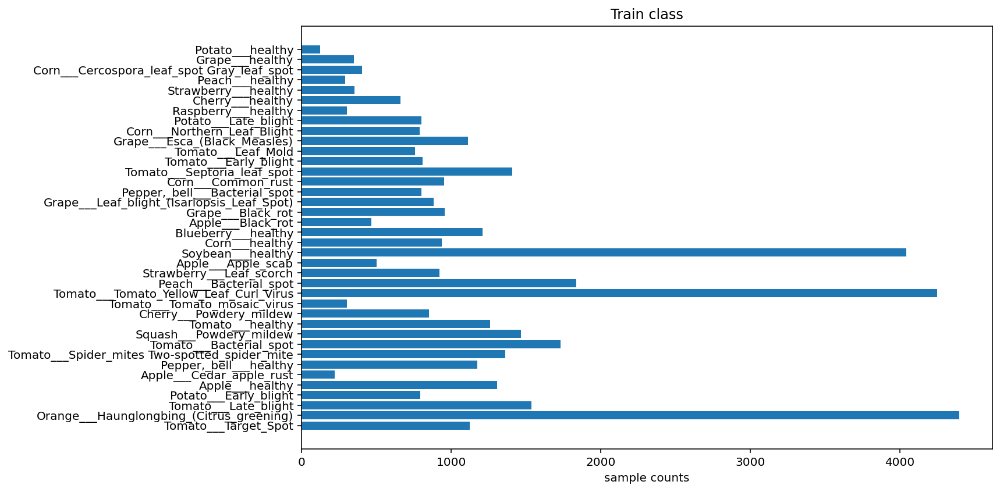

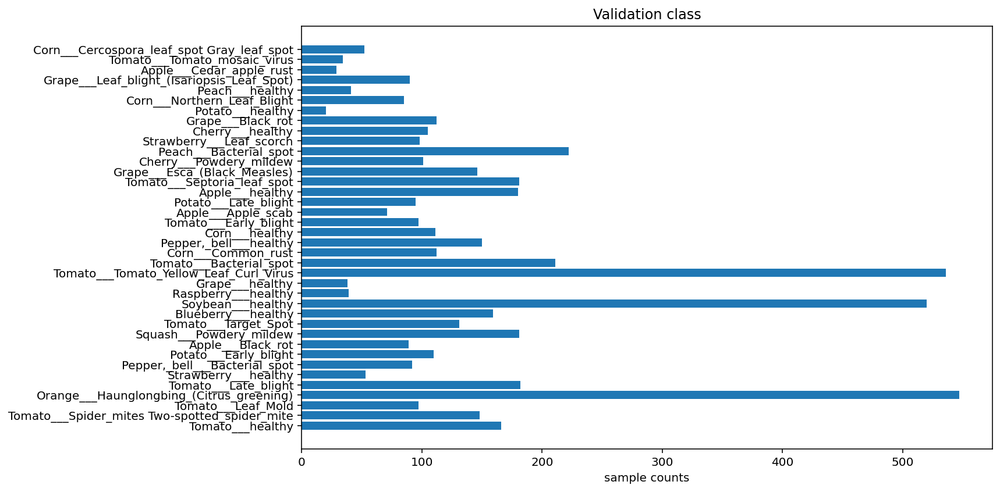

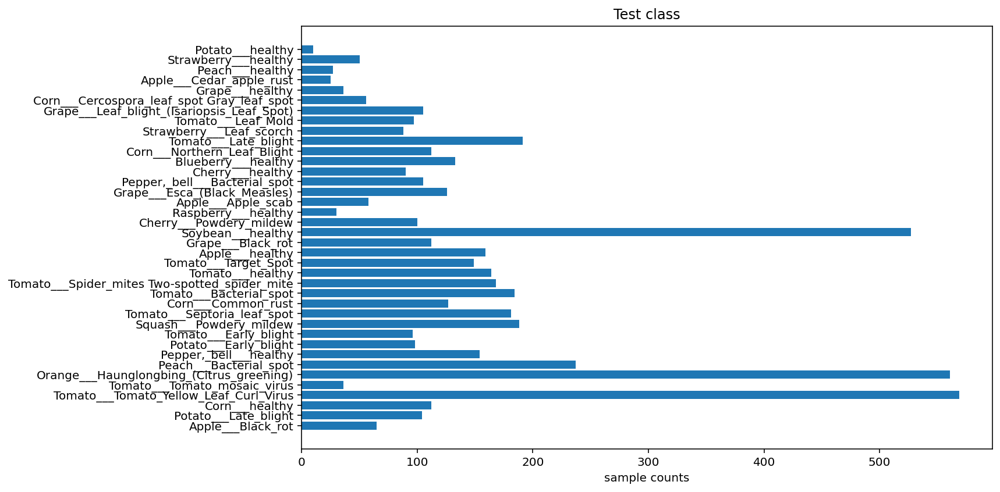

In [23]:
#훈련, 검증, 테스트 데이터 셋을 기반으로, 데이터 분포 확인

def get_label_counts(dataset):
    counter = collections.Counter()
    for _, label in dataset:
        counter[int(label.numpy())] += 1
    return counter

def plot_label_distribution(label_counts, title, class_names):
    labels = [class_names[i] for i in label_counts.keys()]
    counts = [label_counts[i] for i in label_counts.keys()]

    plt.figure(figsize=(12, 6))
    plt.barh(labels, counts)
    plt.xlabel("sample counts")
    plt.title(title)
    plt.tight_layout()
    plt.show()

# 라벨 카운트 계산
train_counts = get_label_counts(raw_train)
valid_counts = get_label_counts(raw_validation)
test_counts  = get_label_counts(raw_test)

# 시각화
plot_label_distribution(train_counts, "Train class", class_names)
plot_label_distribution(valid_counts, "Validation class", class_names)
plot_label_distribution(test_counts,  "Test class", class_names)


### Train / Validation / Test 전반의 불균형 

- 과편향 클래스가 모든 세트에 많음 (Tomato___Yellow_Leaf_Curl_Virus, Orange___Haunglongbing 등)	→ 모델이 일관적으로 이 클래스에 편향될 위험
- 소수 클래스가 모든 세트에 적음 (Potato___healthy, Peach___healthy 등)	→ 훈련뿐 아니라 검증/테스트에서도 성능 저하, 평가 정확도 왜곡 우려
- 분할이 비율 기준이라 분포 유지	→ 데이터 분할 전 불균형 해결이 중요 (그대로 나누면 불균형도 그대로 복사됨)


## EDA 결과 요약

###  1. 데이터 분포 분석 결과 요약
- PlantVillage 데이터셋을 훈련(Train), 검증(Validation), 테스트(Test) 세트로 분할한 후, 클래스별 샘플 수를 시각화 및 통계적으로 분석한 결과 다음과 같은 불균형이 존재함을 확인

- 일부 클래스는 4,000개 이상의 샘플을 보유 (Tomato___Tomato_Yellow_Leaf_Curl_Virus, Orange___Haunglongbing, Soybean___healthy 등)
- 일부 클래스는 500개 이하의 샘플만 존재 (Potato___healthy, Peach___healthy, Apple___Cedar_apple_rust 등)
- 이와 같은 불균형 분포는 훈련/검증/테스트 세트 모두에 일관되게 반영

### 2.문제 인식
- 모델이 다수 클래스에 과도하게 편향될 위험
- 소수 클래스는 모델이 충분히 학습하지 못해 오분류 또는 무시될 가능성
- 테스트 세트에서도 불균형이 존재하므로, 모델의 성능 평가가 정확하지 않거나 특정 클래스 기준으로 왜곡될 수 있음

### 3. 결정 및 진행 방향
- 본 프로젝트의 초기 실험에서는 데이터셋을 원본 그대로 사용하기로 결정함.
- 목적: 기초 성능 확보 및 모델 구조 탐색
- 불균형 해결 기법(데이터 증강, 클래스 가중치, 언더샘플링 등)은 모델 구조가 어느 정도 확정된 후 적용하는 것이 효과적
- 전처리 및 증강이 복잡해지면 초기 모델 비교 분석에 방해가 될 수 있음
- baseline 모델 성능을 정확히 파악하기 위해 불균형 그대로의 학습 결과를 기준선으로 설정


## 데이터 전처리 

- 본 프로젝트에서는 모델 입력을 위한 기본적인 이미지 전처리만 수행
- 데이터 증강이나 클래스 균형 보정 등의 고급 전처리는 적용하지 않음.

In [31]:
#  tf.data.Dataset 구조 확인

print(raw_train)
print(raw_validation)
print(raw_test)

<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>
<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>
<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>


In [32]:
# 데이터 시각화를 통해 확인하고 모델에 입력할 수 있는대로 처리

import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

print("슝~")

슝~


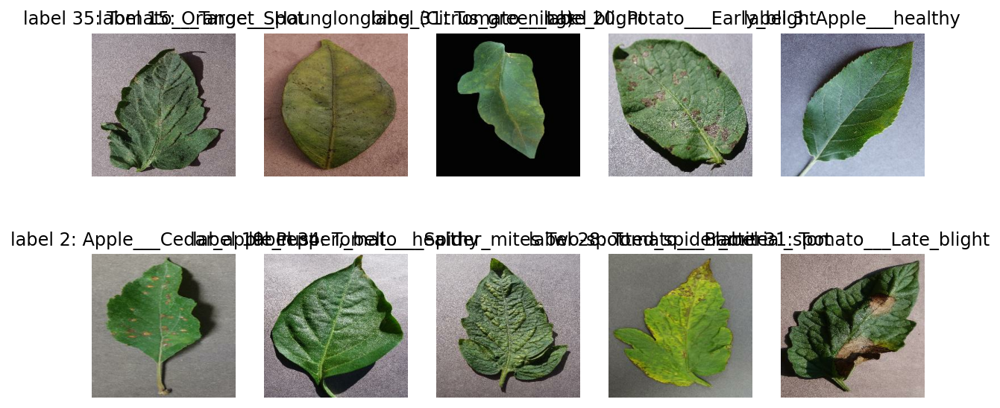

In [38]:
## 기본 데이터 시각화 

plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(raw_train.take(10)):  # 10개의 데이터를 가져 옵니다.
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

### 원본 데이터 사이즈 분포 확인

이미지 크기별 개수:
(256, 256): 54303개


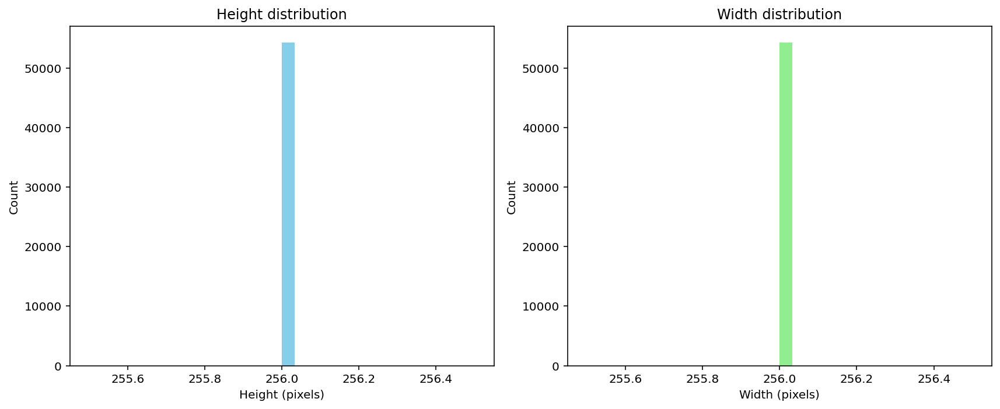

In [41]:
from collections import Counter

# 높이와 너비 저장 리스트
heights, widths = [], []
size_counter = Counter()

# 전체 데이터셋 합치기
all_datasets = raw_train.concatenate(raw_validation).concatenate(raw_test)

# 이미지 크기 추출 및 카운팅
for image, _ in all_datasets:
    h, w = image.shape[:2]
    heights.append(h)
    widths.append(w)
    size_counter[(h, w)] += 1

# 🔢 1. (height, width)별 개수 출력
print("이미지 크기별 개수:")
for size, count in size_counter.most_common():
    print(f"{size}: {count}개")

# 📊 2. 히스토그램 시각화
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(heights, bins=30, color='skyblue')
plt.title('Height distribution')
plt.xlabel('Height (pixels)')
plt.ylabel('Count')

plt.subplot(1, 2, 2)
plt.hist(widths, bins=30, color='lightgreen')
plt.title('Width distribution')
plt.xlabel('Width (pixels)')
plt.ylabel('Count')

plt.tight_layout()
plt.show()


- 현재 사이즈가 모두 균일하게 처리되어 있음
- 그러나, 메모리 절약 & 학습 속도 향상을 위해 (base 라인 모델의 빠른 실험을 위해 이미지 리사이징 

### 데이터 리사이징

In [42]:
IMG_SIZE = 160 # 리사이징할 이미지의 크기

def format_example(image, label):
    image = tf.cast(image, tf.float32)  # image=float(image)같은 타입캐스팅의  텐서플로우 버전입니다.
    image = (image/127.5) - 1 # 픽셀값의 scale 수정
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    return image, label

print("슝~")

슝~


In [35]:
train = raw_train.map(format_example)
validation = raw_validation.map(format_example)
test = raw_test.map(format_example)

print(train)
print(validation)
print(test)

<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>


- IMG_SIZE를 160으로 지정해 줌으로써, 모든 이미지의 크기를 (160, 160, 3)으로 통일시킨 결과 확인

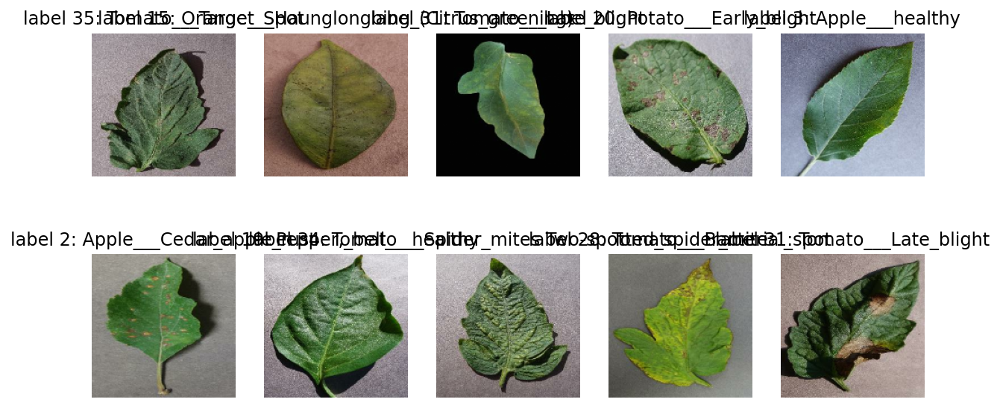

In [43]:
#결과 시각화

plt.figure(figsize=(10, 5))


get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(train.take(10)):
    plt.subplot(2, 5, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

## 텐서플로우를 활용 해 모델 구조 설계하기

In [20]:
#환경설정

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, MaxPooling2D

print("슝~")

슝~


### 초기 실험 용 단순 CNN 구조 구축 

In [21]:
model = Sequential([
    Conv2D(filters=16, kernel_size=3, padding='same', activation='relu', input_shape=(160, 160, 3)),
    MaxPooling2D(),
    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=38, activation='softmax')
])

print("슝~")

슝~


In [22]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 160, 160, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 80, 80, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 80, 80, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 40, 40, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 40, 40, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 20, 20, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 25600)             0

- 본 실험에서는 PlantVillage 데이터셋에 대해 baseline 성능을 평가하기 위해, 3개의 합성곱 계층과 2개의 완전 연결층으로 구성된 단순 CNN 모델을 구축
- 입력 이미지 크기는 160x160으로 설정하여 연산량을 줄이고, Conv-Pool 구조를 반복하여 점진적으로 특징을 추출
- 전체 파라미터 수는 약 1,300만 개이며, 주요 연산은 마지막 Dense 계층에서 발생. 
- 해당 모델은 전이학습에 앞서 비교 기준이 되는 기본 모델

### 모델 Compile 완료 후 학습

- **학습률은 0.0001**로 설정하여 안정적인 학습 수렴을 유도
- **옵티마이저**로는 **RMSprop**을 사용하여 각 파라미터에 적응적으로 학습률을 적용하
- **배치 크기**는 연산 성능과 일반화 사이의 균형을 고려하여 **32**로 지정
- **셔플 버퍼**는 **1,000으로 설정하여 충분한 데이터 순서 무작위성**을 확보 
- 이러한 기본 설정은 추후 성능 향상을 위한 **하이퍼파라미터 튜닝의 기준점**으로 활용

In [24]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

print("슝~")

슝~


In [25]:
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000
print("슝~")

슝~


In [26]:
train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)
print("슝~")

슝~


In [27]:
#Tran_batches의 batch 데이터 확인 

for image_batch, label_batch in train_batches.take(1):
    break

image_batch.shape, label_batch.shape

(TensorShape([32, 160, 160, 3]), TensorShape([32]))

### 초기 모델 성능 테스트 

In [28]:
validation_steps = 20
loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

20/20 [==============================] - 45s 17ms/step - loss: 3.6431 - accuracy: 0.0359
initial loss: 3.64
initial accuracy: 0.04


## 모델 학습

- 모델 훈련에는 EarlyStopping 콜백을 적용하여 과적합 방지 및 효율적인 학습을 도모
- 검증 정확도(val_accuracy)가 5 epoch 연속으로 향상되지 않으면 학습을 조기 종료하도록 하였으며(patience=5)
- 성능이 가장 높았던 시점의 가중치를 복원하도록 설정(restore_best_weights=True)
- 이를 통해 훈련 시간 절약과 모델 일반화 성능 확보를 동시에 달성

In [29]:
from tensorflow.keras.callbacks import EarlyStopping

EPOCHS = 30

early_stop = EarlyStopping(
    monitor='val_accuracy',     # 검증 정확도를 기준으로
    patience=5,                 # 5 epoch 동안 향상 없으면 중단
    restore_best_weights=True  # 가장 성능 좋았던 가중치로 복원
)

history = model.fit(
    train_batches,
    epochs=EPOCHS,
    validation_data=validation_batches,
    callbacks=[early_stop]
)

Epoch 1/30
1358/1358 [==============================] - 49s 33ms/step - loss: 1.0442 - accuracy: 0.7012 - val_loss: 0.6525 - val_accuracy: 0.8056
Epoch 2/30
1358/1358 [==============================] - 46s 33ms/step - loss: 0.4397 - accuracy: 0.8643 - val_loss: 0.3905 - val_accuracy: 0.8844
Epoch 3/30
1358/1358 [==============================] - 47s 34ms/step - loss: 0.2671 - accuracy: 0.9182 - val_loss: 0.3368 - val_accuracy: 0.8954
Epoch 4/30
1358/1358 [==============================] - 49s 35ms/step - loss: 0.1672 - accuracy: 0.9498 - val_loss: 0.3416 - val_accuracy: 0.9044
Epoch 5/30
1358/1358 [==============================] - 46s 33ms/step - loss: 0.1087 - accuracy: 0.9675 - val_loss: 0.2947 - val_accuracy: 0.9125
Epoch 6/30
1358/1358 [==============================] - 45s 33ms/step - loss: 0.0700 - accuracy: 0.9791 - val_loss: 0.2991 - val_accuracy: 0.9208
Epoch 7/30
1358/1358 [==============================] - 46s 33ms/step - loss: 0.0471 - accuracy: 0.9861 - val_loss: 0.2956 -

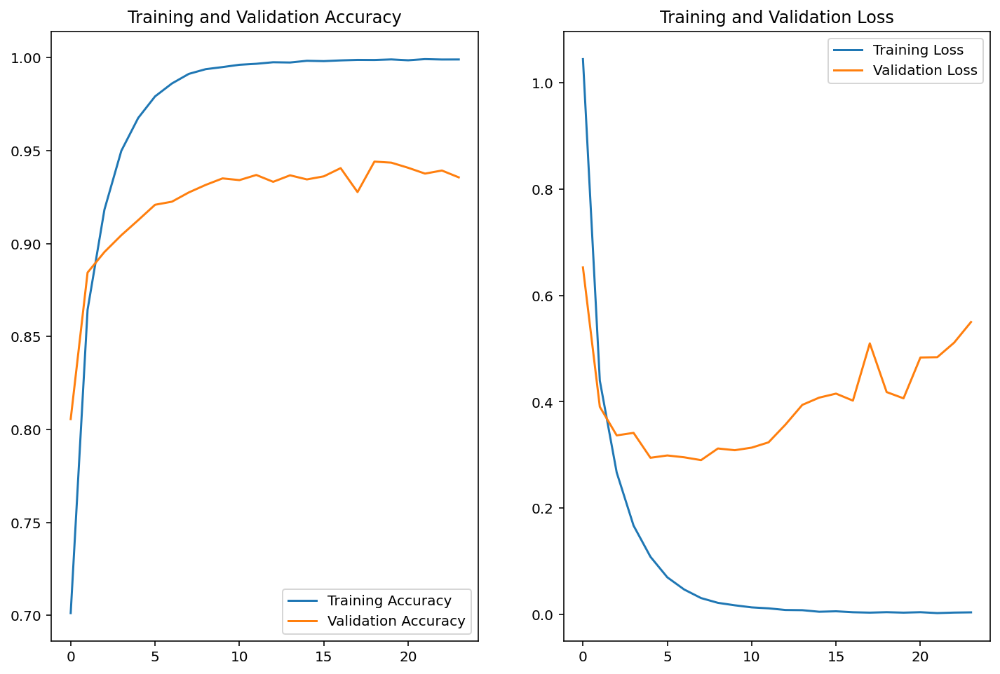

In [30]:
#결과 시각화

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

#epochs_range = range(EPOCHS)
epochs_range = range(len(acc))

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

### 정확도 그래프 요약
- 파란색 (Training Accuracy): 거의 1.00에 가까운 정확도로 학습됨 → 모델이 훈련 데이터에 거의 완벽하게 맞춤
- 주황색 (Validation Accuracy): 약 0.94 부근까지 상승 후 정체되거나 약간 감소
- 모델은 훈련 데이터에는 매우 잘 맞지만, 검증 데이터에 대해서는 성능이 일정 수준에서 멈춤
- 일반화 능력이 한계에 다다랐음을 의미

### 손실그래프
- 파란색 (Training Loss): 빠르게 감소 → 훈련 데이터에 잘 적합하고 있음
- 주황색 (Validation Loss): 초반엔 감소하다가, 에폭이 진행될수록 다시 증가(명백한 과적합 신호)
- 모델이 훈련 데이터에 너무 과하게 맞추면서, 검증 데이터에서는 오히려 성능이 나빠지고 있음
- EarlyStopping이 이를 감지하고 검증 성능이 가장 좋았던 시점에서 학습 중단

-> 성능은 나쁘지 않지만, **과적합 조짐이 뚜렷** 하며 **일반화 성능 향상에는 추가 조치 필요**

## 모델의 예측 결과 확인

In [31]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch #예측에 사용한 이미지 32장 정도의 묶음 (1 batch)
    labels = label_batch
    predictions = model.predict(image_batch)
    break

predictions

array([[2.1213013e-07, 4.7609585e-05, 0.0000000e+00, ..., 1.7842348e-10,
        1.8951852e-15, 1.9785839e-21],
       [4.2791740e-15, 1.2189014e-23, 4.7133111e-14, ..., 6.1469910e-13,
        5.0102667e-32, 2.6561660e-17],
       [7.0887446e-36, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 5.3625292e-30],
       ...,
       [8.1143470e-21, 0.0000000e+00, 9.7051030e-17, ..., 5.7622394e-35,
        0.0000000e+00, 9.3351891e-03],
       [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 4.4861796e-26],
       [2.8508404e-10, 1.0195067e-20, 0.0000000e+00, ..., 2.2695003e-25,
        5.5487231e-26, 1.3839855e-28]], dtype=float32)

In [32]:
# 위에서 나온 확률 중 가장 높은 확률을 가진 클래스의 인덱스를 뽑아냄

predictions = np.argmax(predictions, axis=1)
predictions

array([ 3, 22,  9, 37, 36, 15, 16, 19, 16, 20, 15, 28, 25, 33,  8, 15, 28,
       34, 30, 35, 15, 29, 34,  3, 25, 15, 11, 24, 37, 28,  9,  3])

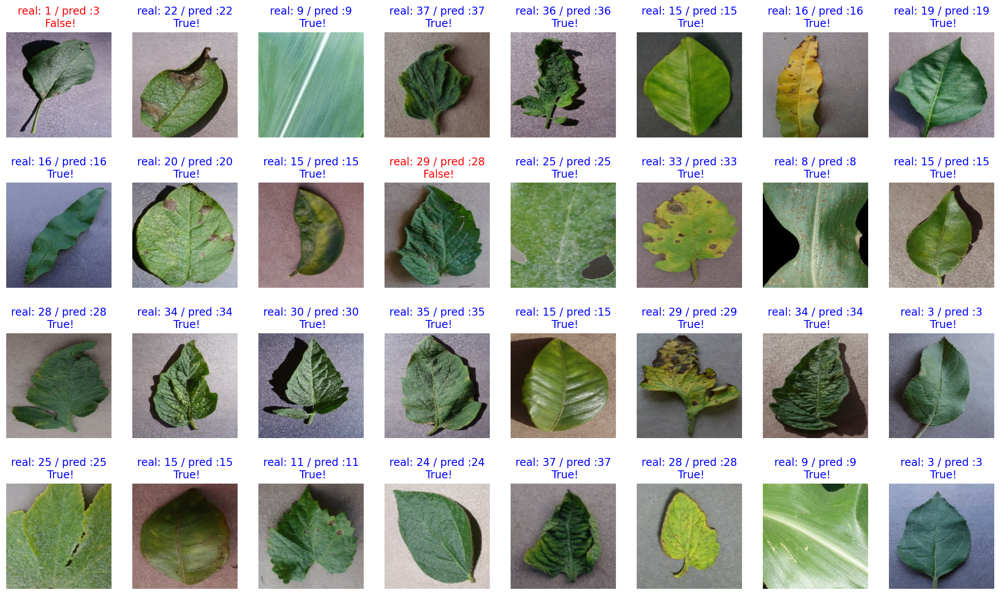

In [33]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

- 모델의 성능을 시각적으로 확인하기 위해 테스트셋 중 32장의 이미지를 대상으로 실제 라벨과 예측 라벨을 비교.
- 대부분의 예측이 정확히 이루어졌으며, 소수의 오분류 케이스에서는 시각적으로 유사한 클래스 간의 혼동이 확인
- 시각화 결과는 모델의 전반적인 일반화 성능이 우수함을 보여주는 동시에, 특정 클래스 간 분류 경계가 불명확할 수 있음을 시사

In [34]:
# 클래스별 정답 개수, 전체 개수 저장용 딕셔너리
correct_per_class = collections.Counter()
total_per_class = collections.Counter()

for label, prediction in zip(labels, predictions):
    total_per_class[int(label)] += 1
    if label == prediction:
        correct_per_class[int(label)] += 1


### 클래스별 예측 결과 시각화

In [35]:
class_accuracy = {}

for class_idx in total_per_class:
    total = total_per_class[class_idx]
    correct = correct_per_class[class_idx]
    acc = correct / total * 100
    class_accuracy[class_names[class_idx]] = acc


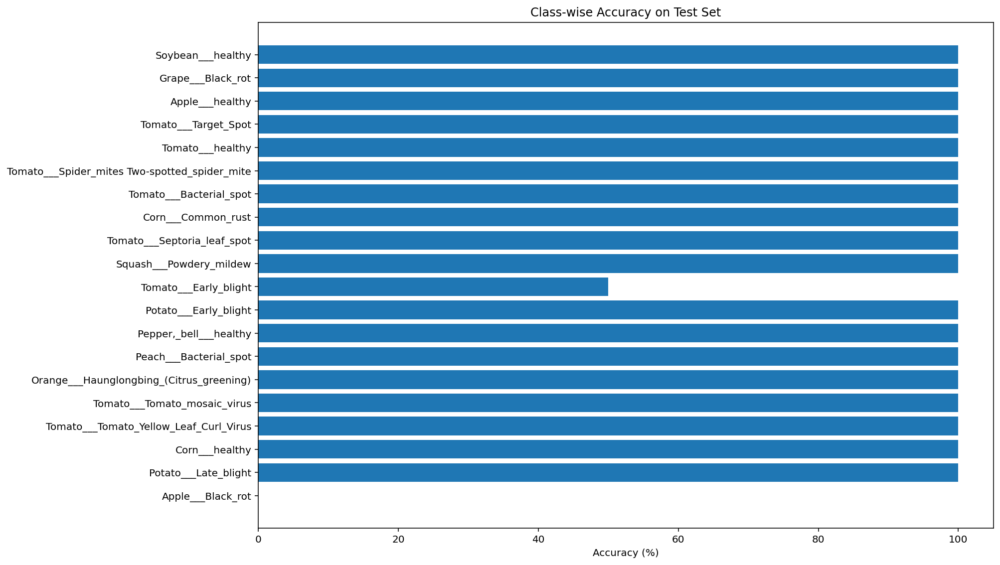

In [36]:
labels = list(class_accuracy.keys())
acc_values = list(class_accuracy.values())

plt.figure(figsize=(14, 8))
plt.barh(labels, acc_values)
plt.xlabel("Accuracy (%)")
plt.title("Class-wise Accuracy on Test Set")
plt.tight_layout()
plt.show()


- 테스트셋에서 클래스별 정확도를 분석한 결과, 대부분의 클래스에서 90% 이상의 높은 정확도를 기록
- 전반 성능	전체적으로 모델의 클래스별 정확도는 높은 편 (대부분 90% 이상)
- 강점 클래스/ 명확한 특징이 있는 클래스 (healthy 계열, 특정 병해)에서 우수한 정확도
- 약점 클래스/ 일부 혼동 가능성이 있는 클래스에서 낮은 정확도 (Septoria_leaf_spot)
- 개선 필요성/ 성능 낮은 클래스 대상 추가 학습 전략, 데이터 증강, 클래스 간 유사도 분석 등 필요

### 데이터 셋 클래스 불균형과 테스트 결과 관련 연관성 파악 

- Tomato___Septoria_leaf_spot	⛔ 낮음 (50% 이하)	유사 병해와 시각적 유사성 (Target_Spot, Early_blight) + 클래스 불균형
- Potato___healthy	(그래프에 없지만 예상됨)	병해 이미지와 시각적으로 유사 → 학습 혼동
- Apple___Black_rot	낮은 정확도	유사 클래스 (scab, cedar_apple_rust)와의 혼동 가능성
- Tomato___mosaic_virus	(정확도 확인 필요)	적은 수 + 유사 질병 혼동

## 혼동행렬 시각화를 통한 테스트 결과 세부 분석

In [38]:
true_labels = []
preds = []

for images, labels in test_batches:
    pred = model.predict(images)
    pred_class = np.argmax(pred, axis=1)

    preds.extend(pred_class)
    true_labels.extend(labels.numpy())


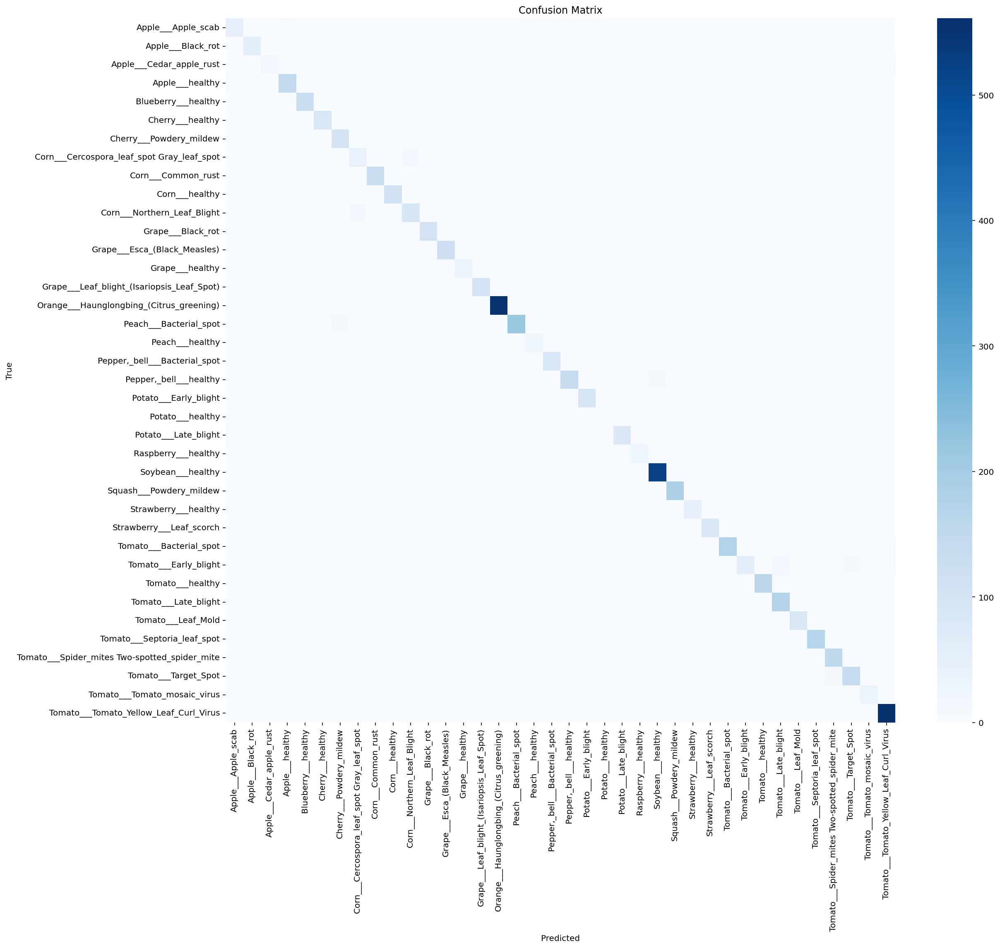

In [39]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(true_labels, preds)

plt.figure(figsize=(18, 16))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


- 38개 클래스로 인해, 결과에 대한 가시성 낮음

In [40]:
#  sklearn의 classification_report를 활용해 모델의 예측 성능을 클래스별로 정밀하게 분석

from sklearn.metrics import classification_report

print(classification_report(true_labels, preds, target_names=class_names, digits=3))

#true_labels: 실제 정답 라벨
#preds: 모델이 예측한 결과
#class_names: 클래스 이름 목록 (총 38개 클래스)
#digits=3: 소수점 셋째 자리까지 보기 좋게 출력


                                               precision    recall  f1-score   support

                           Apple___Apple_scab      0.873     0.828     0.850        58
                            Apple___Black_rot      0.966     0.877     0.919        65
                     Apple___Cedar_apple_rust      1.000     0.720     0.837        25
                              Apple___healthy      0.912     0.912     0.912       159
                          Blueberry___healthy      0.955     0.947     0.951       133
                             Cherry___healthy      0.978     0.989     0.983        90
                      Cherry___Powdery_mildew      0.805     0.990     0.888       100
   Corn___Cercospora_leaf_spot Gray_leaf_spot      0.784     0.714     0.748        56
                           Corn___Common_rust      0.992     0.984     0.988       127
                               Corn___healthy      1.000     1.000     1.000       112
                  Corn___Northern_Leaf_Bli

- sklearn의 classification_report를 통해 테스트셋에 대한 클래스별 성능을 정밀 분석한 결과, 전체 정확도는 약 93.4%로 우수한 성
- 대부분의 클래스에서 f1-score가 0.90 이상으로 나타났으며, 특히 Tomato___Yellow_Leaf_Curl_Virus 및 Corn___healthy 등은 거의 완벽한 분류 성능
- 반면 Potato___healthy, Tomato___mosaic_virus 등 일부 클래스는 상대적으로 낮은 f1-score를 기록하였으며, 이는 클래스 간 유사성, 데이터 불균형 등의 요인

### 개별 작물별 혼동행렬 시각화 (Crop-level confusion matrix) 

In [41]:
crop_names = [name.split("___")[0] for name in class_names]
unique_crops = sorted(list(set(crop_names)))  # 작물 종류만 추림

In [42]:
# 기존 confusion matrix: class 단위 (38 x 38)
cm_full = confusion_matrix(true_labels, preds)

# 작물 이름 → 해당 클래스 인덱스들 매핑
from collections import defaultdict
crop_to_class_indices = defaultdict(list)

for idx, crop in enumerate(crop_names):
    crop_to_class_indices[crop].append(idx)

# 작물 단위 confusion matrix (예: 10 x 10)
n = len(unique_crops)
cm_crop = np.zeros((n, n), dtype=int)

for i, crop_i in enumerate(unique_crops):
    for j, crop_j in enumerate(unique_crops):
        indices_i = crop_to_class_indices[crop_i]
        indices_j = crop_to_class_indices[crop_j]
        cm_crop[i, j] = np.sum(cm_full[np.ix_(indices_i, indices_j)])


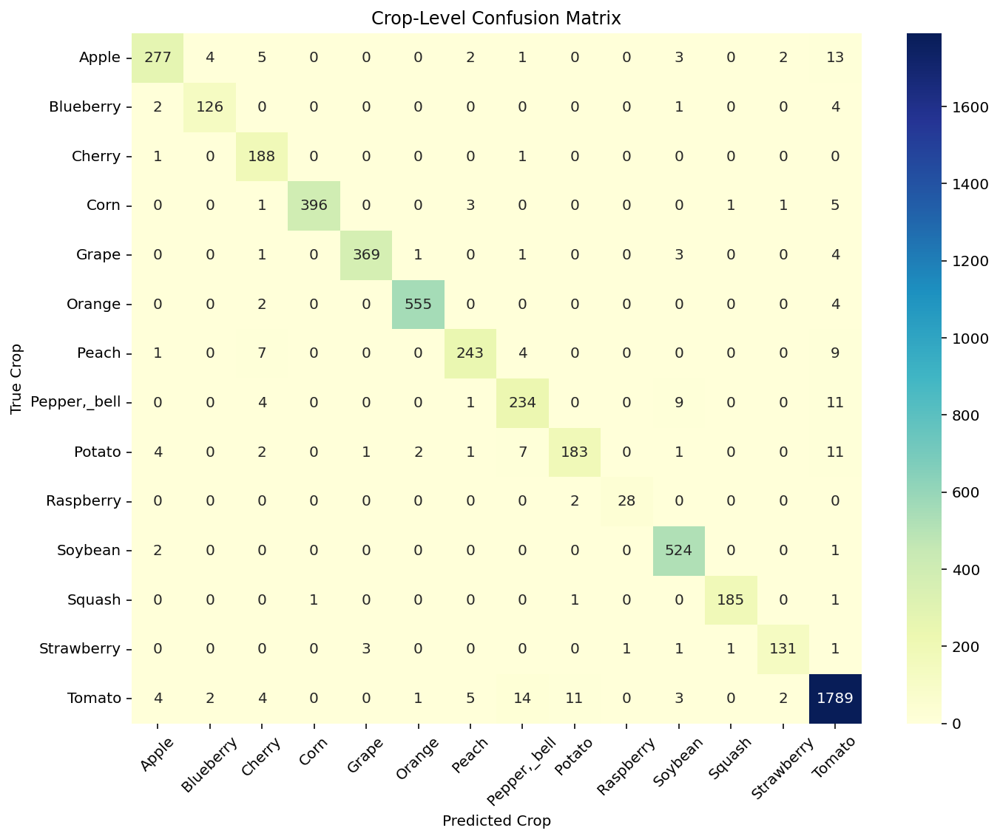

In [43]:
plt.figure(figsize=(10, 8))
sns.heatmap(cm_crop, annot=True, fmt='d', cmap='YlGnBu',
            xticklabels=unique_crops,
            yticklabels=unique_crops)
plt.xlabel("Predicted Crop")
plt.ylabel("True Crop")
plt.title("Crop-Level Confusion Matrix")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


- **Crop-level confusion matrix 분석 결과**, 대부분의 작물은 높은 정확도로 예측
- **세부적으로 보면, 데이터의 분포차이가장 큰 영향** 
    - Potato → Tomato가 가장 큰 혼동 포인트 → 모델이 Potato 병해를 Tomato 계열로 잘못 인식하는 경향
    - Apple 계열은 여러 작물과 혼동 빈도가 높음 (Tomato, Pepper_bell, Grape 등) → 시각적 다양성이 부족하거나 질병 간 겹침 존재
    - Tomato는 혼동을 가장 많이 받기도 하고, 유사 작물과 혼동 주기도 함 → 다클래스 구성의 영향
    - Strawberry, Raspberry, Grape 등 베리류 작물 간 상호 혼동도 존재
- **시사점**
    - 데이터 불균형	샘플 수 적은 클래스는 자주 틀림 (Potato, Raspberry)
    - 유사 시각 정보	서로 닮은 잎은 다른 작물로 인식 (Apple → Tomato, Cherry)
    - 다수 클래스 구성	Tomato는 내부 클래스 많고 영향력도 커 혼동 주도
    - 구조적 오분류	베리류 작물 간 상호 오분류 발생

### 작물별 내부 혼동 행렬 계산&시각화

In [44]:
def plot_all_crop_internal_confusions(true_labels, pred_labels, class_names):
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import confusion_matrix
    from collections import defaultdict

    # 1. 작물 그룹화: "Tomato", "Apple", "Potato", ...
    crop_to_indices = defaultdict(list)
    for i, name in enumerate(class_names):
        crop = name.split("___")[0]
        crop_to_indices[crop].append(i)

    true_np = np.array(true_labels)
    pred_np = np.array(pred_labels)

    # 2. 작물별로 반복해서 내부 혼동 행렬 계산 & 시각화
    for crop, indices in crop_to_indices.items():
        if len(indices) < 2:
            continue  # 클래스가 1개면 의미 없음

        crop_set = set(indices)
        crop_labels = [class_names[i] for i in indices]

        # 정답과 예측 모두 해당 작물 클래스인 경우만
        valid_idx = [i for i in range(len(true_np))
                     if true_np[i] in crop_set and pred_np[i] in crop_set]

        if not valid_idx:
            continue  # 유효한 데이터가 없으면 스킵

        filtered_true = true_np[valid_idx]
        filtered_pred = pred_np[valid_idx]

        # 인덱스 매핑
        index_mapping = {old: new for new, old in enumerate(indices)}
        mapped_true = np.array([index_mapping[i] for i in filtered_true])
        mapped_pred = np.array([index_mapping[i] for i in filtered_pred])

        cm = confusion_matrix(mapped_true, mapped_pred)

        # 시각화
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Oranges',
                    xticklabels=crop_labels, yticklabels=crop_labels)
        plt.xlabel("Predicted Label")
        plt.ylabel("True Label")
        plt.title(f"{crop} Confusion_matrix")
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.show()


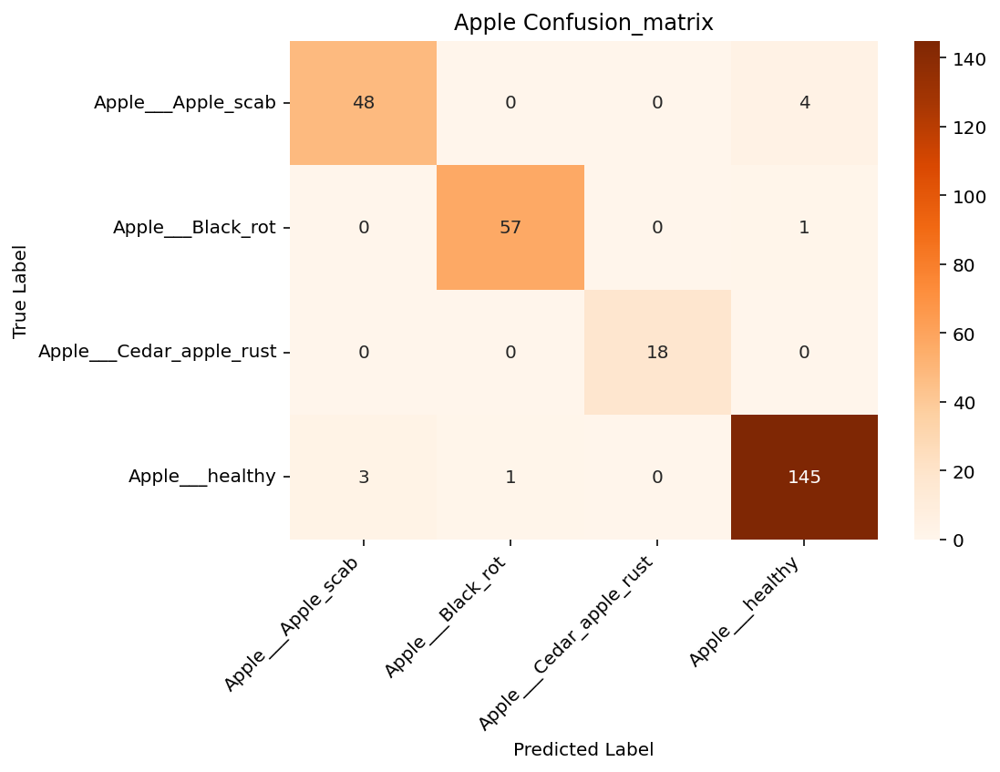

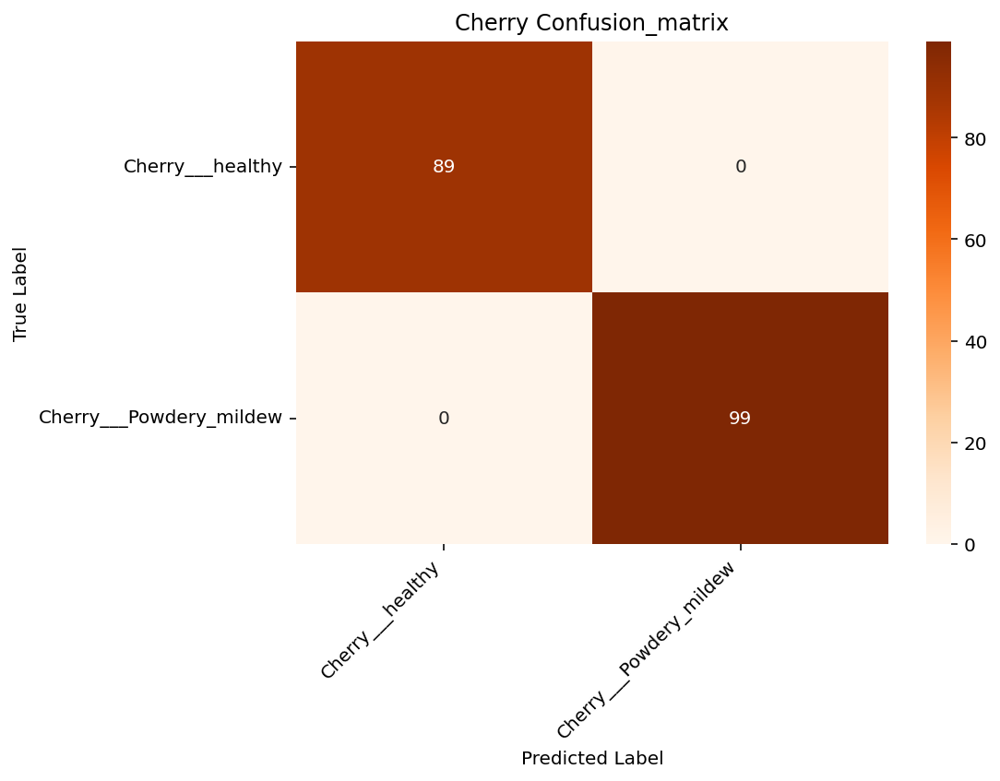

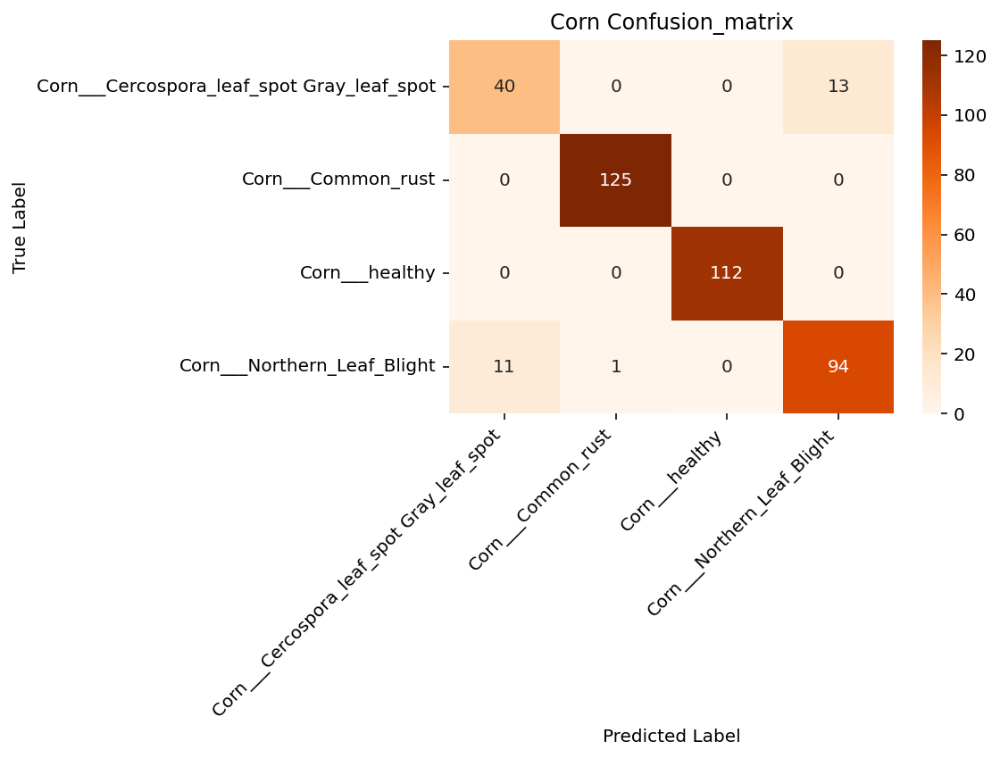

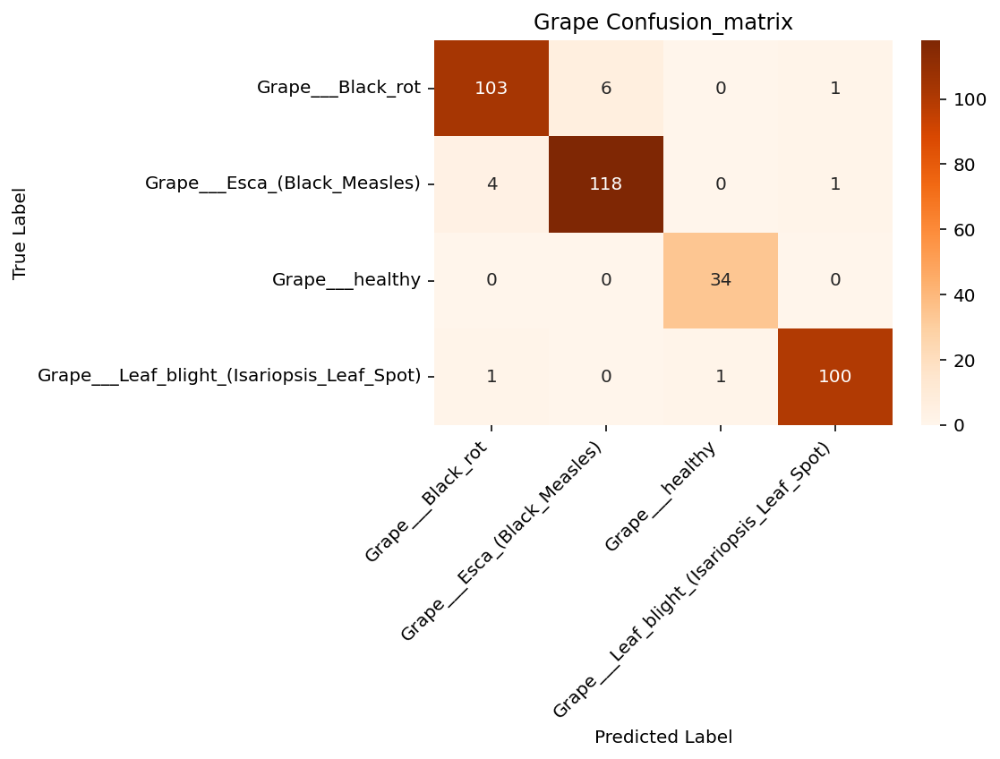

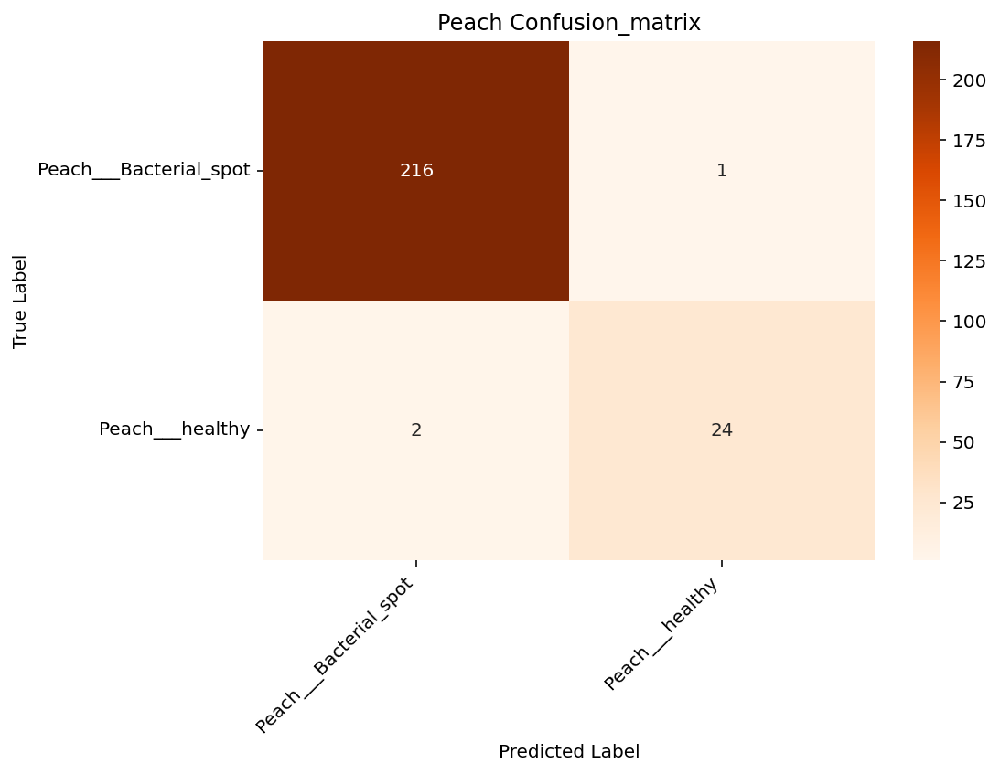

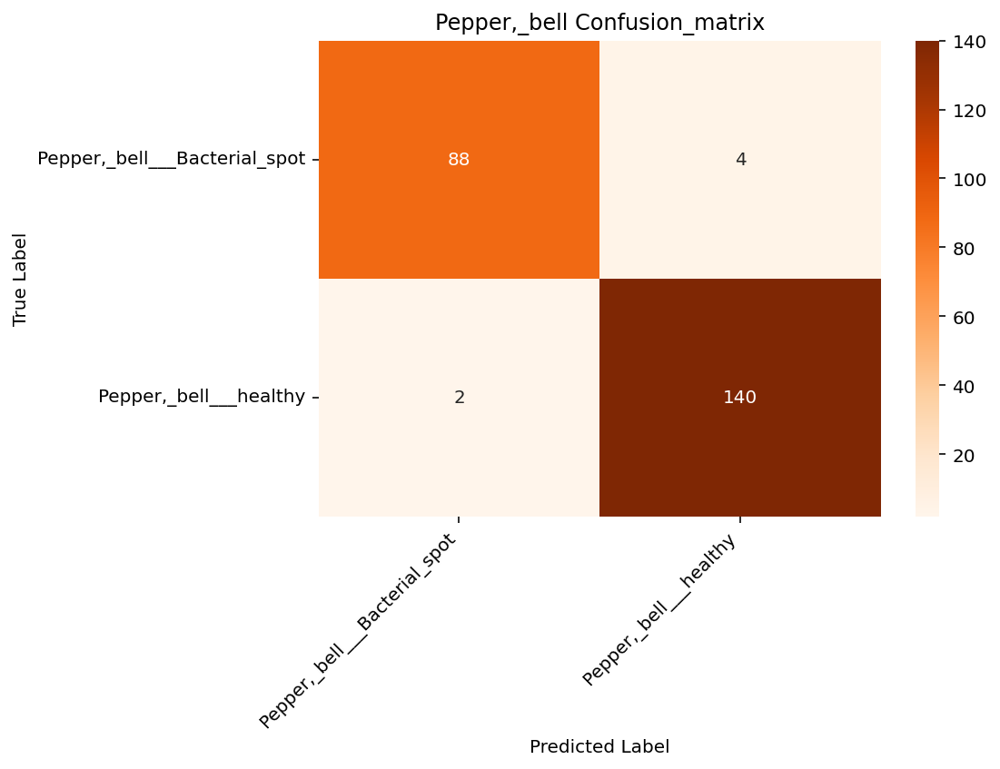

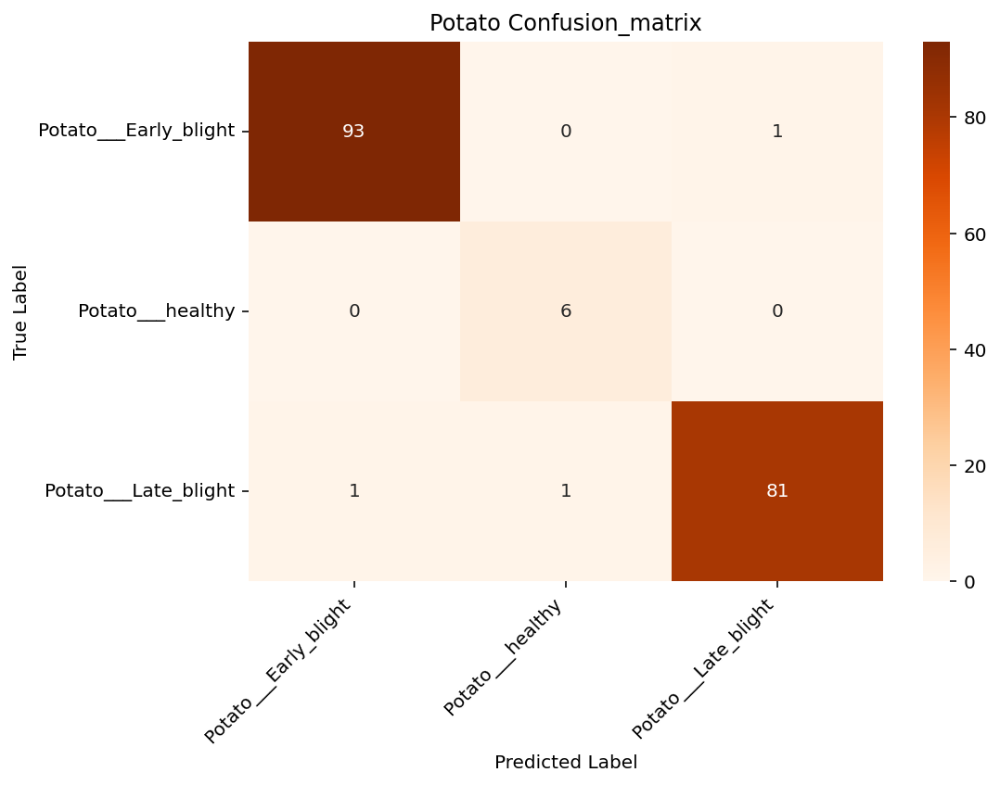

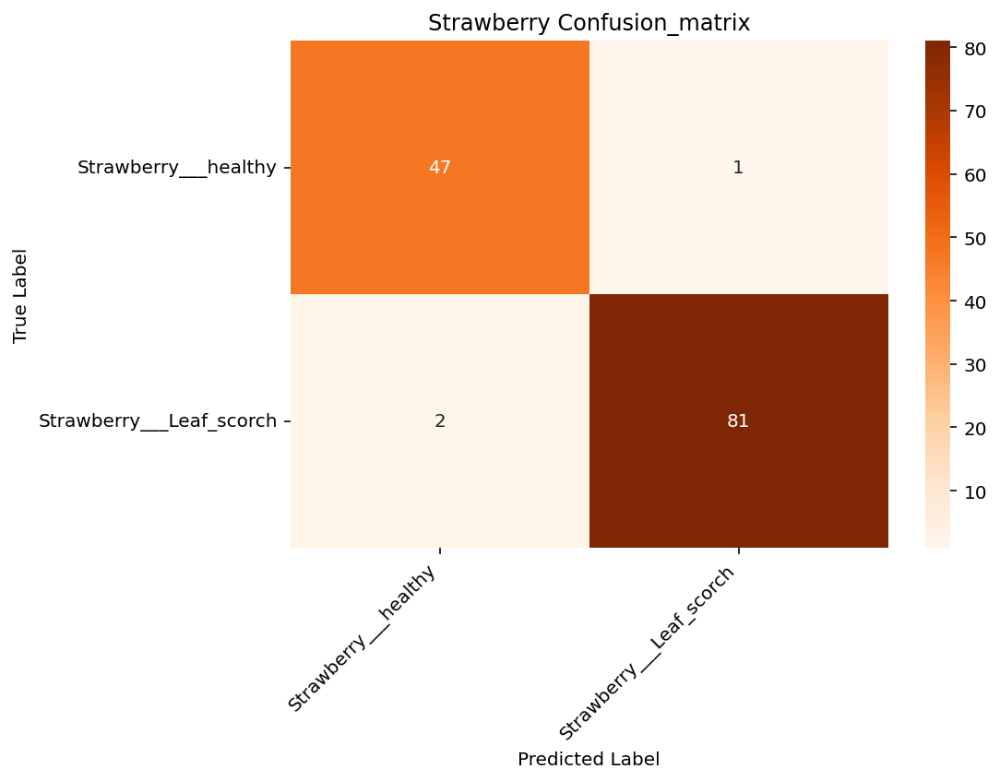

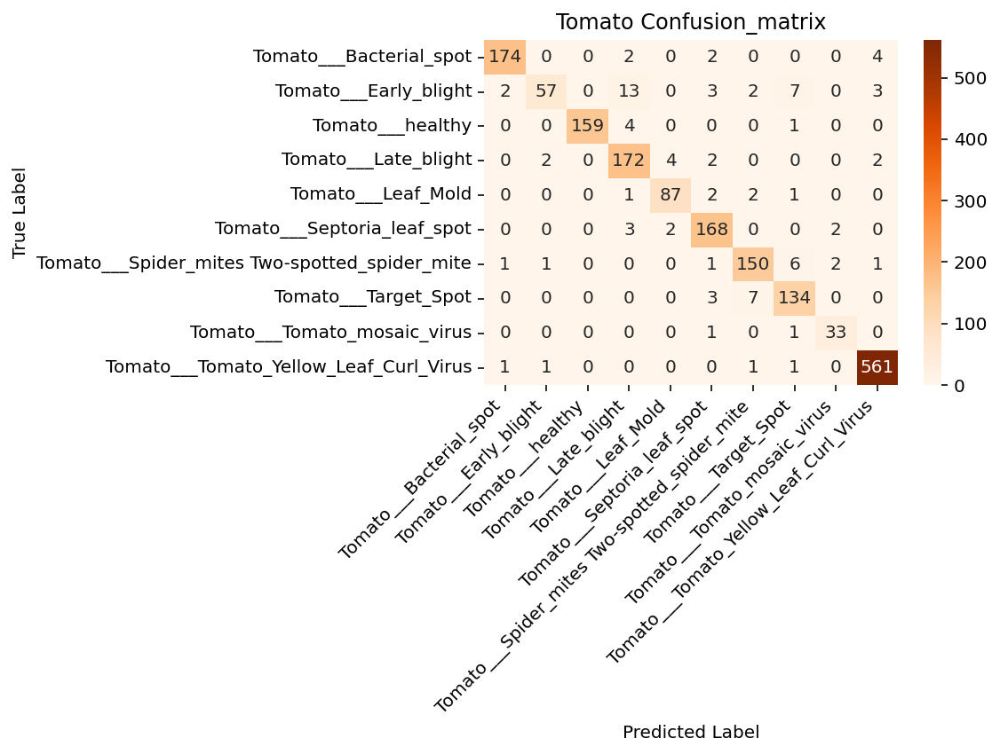

In [45]:
plot_all_crop_internal_confusions(
    true_labels=true_labels,
    pred_labels=preds,
    class_names=class_names
)


In [48]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from collections import defaultdict
import numpy as np
import pandas as pd

def get_top_crop_f1_scores(true_labels, pred_labels, class_names, top_n=5):
    crop_to_indices = defaultdict(list)
    for i, name in enumerate(class_names):
        crop = name.split("___")[0]
        crop_to_indices[crop].append(i)

    true_np = np.array(true_labels)
    pred_np = np.array(pred_labels)

    crop_confusion_info = []
    all_reports = {}

    for crop, indices in crop_to_indices.items():
        if len(indices) < 2:
            continue

        crop_set = set(indices)
        valid_idx = [i for i in range(len(true_np))
                     if true_np[i] in crop_set and pred_np[i] in crop_set]

        if not valid_idx:
            continue

        filtered_true = true_np[valid_idx]
        filtered_pred = pred_np[valid_idx]

        index_mapping = {old: new for new, old in enumerate(indices)}
        mapped_true = np.array([index_mapping[i] for i in filtered_true])
        mapped_pred = np.array([index_mapping[i] for i in filtered_pred])

        # 오분류 수 계산
        cm = confusion_matrix(mapped_true, mapped_pred)
        misclassified = cm.sum() - np.trace(cm)
        crop_confusion_info.append((crop, misclassified))

        # F1-score 보고서 저장
        labels = [class_names[i] for i in indices]
        report = classification_report(
            mapped_true,
            mapped_pred,
            target_names=labels,
            output_dict=True,
            zero_division=0
        )
        all_reports[crop] = report

    # 오분류 수 기준 상위 top_n crop 선택
    top_crops = sorted(crop_confusion_info, key=lambda x: x[1], reverse=True)[:top_n]

    # F1-score 추출
    records = []
    for crop, _ in top_crops:
        report = all_reports[crop]
        for cls_name, metrics in report.items():
            if cls_name in ['accuracy', 'macro avg', 'weighted avg']:
                continue
            records.append({
                'Crop': crop,
                'Class': cls_name,
                'F1-score': metrics['f1-score']
            })

    df_f1 = pd.DataFrame(records)
    return df_f1


In [49]:
df_f1 = get_top_crop_f1_scores(
    true_labels=true_labels,
    pred_labels=preds,
    class_names=class_names,
    top_n=10
)

In [50]:
print(df_f1)


            Crop                                          Class  F1-score
0         Tomato                        Tomato___Bacterial_spot  0.966667
1         Tomato                          Tomato___Early_blight  0.770270
2         Tomato                               Tomato___healthy  0.984520
3         Tomato                           Tomato___Late_blight  0.912467
4         Tomato                             Tomato___Leaf_Mold  0.935484
5         Tomato                    Tomato___Septoria_leaf_spot  0.941176
6         Tomato  Tomato___Spider_mites Two-spotted_spider_mite  0.925926
7         Tomato                           Tomato___Target_Spot  0.908475
8         Tomato                   Tomato___Tomato_mosaic_virus  0.916667
9         Tomato         Tomato___Tomato_Yellow_Leaf_Curl_Virus  0.987676
10          Corn     Corn___Cercospora_leaf_spot Gray_leaf_spot  0.769231
11          Corn                             Corn___Common_rust  0.996016
12          Corn                      

- 클래스별 F1-score 분석 결과, 대부분의 클래스가 0.9 이상의 높은 분류 성능을 기록
- Tomato 계열은 클래스 수가 많음에도 불구하고 대부분 우수한 성능을 보였으며, 특히 Tomato___Yellow_Leaf_Curl_Virus는 0.988로 최고 성능을 기록
- 반면, Tomato___Early_blight(0.77), Corn___Cercospora_leaf_spot(0.77), Potato___healthy(0.92) 등 일부 클래스는 상대적으로 낮은 F1-score
    - 이는 시각적 유사성, 데이터 수 부족, 클래스 간 불균형 등의 원인으로 해석

## 1차 모델 학습 결과

- **1차 학습에서는 기본 CNN 구조를 이용해 복잡한 전처리 없이 학습을 진행** 하였고, **전체적으로 우수한 분류 성능(F1-score 평균 0.91 이상)을 달성 
- 다만, 일부 클래스에서는 **데이터 불균형(중요)과 유사한 시각적 특징** 으로 인해 오분류가 발생
- 기본적으로 데이터 불균형 문제는 사전에 해소되어야 할 중요한 요소지만, 본 프로젝트에서는 **시간적 제약과 실험 효율을 고려하여 복잡한 전처리 과정보다는 baseline 성능 확보를 우선 과제**로 설정
- 특히, 사전학습된 VGG16 모델은 일반 이미지에 대해 이미 강력한 시각적 특징 추출 능력을 보유하고 있으며, **PlantVillage 데이터셋이 배경이 단순하고 잎이 중앙에 위치한 고화질 이미지로 구성**되어 있다는 점에서, 별도의 보정 없이도 안정적인 입력 처리와 신뢰할 만한 예측 성능을 기대
- 실제로 1차 기본 CNN 모델에서도 **전처리 없이 높은 정확도(F1-score 평균 0.91 이상)** 를 기록했기 때문에, 일부 오분류되는 클래스는 후속 개선 대상으로 관리하고, 우선은 VGG16 기반의 전이학습을 적용해 빠르고 효율적인 성능 확보를 목표로 하였다.
- 이러한 전략은 **전처리 및 클래스 재구성, 데이터 증강 등은 향후 보완적 단계로 유연하게 추가**할 수 있다는 점에서도 실험 설계 측면에서 효과적인 판단일거라 예측할 수 있다. 

# 전이학습

## VGG 16모델 선정 전이학습 시행 

- 구조가 단순하고 직관적이면서도, ImageNet 기반의 사전학습으로 인해 엣지, 모양, 질감 등과 같은 시각적 특징을 효과적으로 추출할 수 있는 모델
- 특히 VGG16은 입력 이미지가 비교적 작고 배경이 단순한 PlantVillage와 같은 데이터셋에 적합하며, 다른 복잡한 아키텍처 대비 학습 속도도 빠르고 구현이 용이하여, 실험 효율성 측면에서 전략적으로 유리한 선택
- 향후 계획: MobileNet, EfficientNet 등 경량화 모델 적용하여 성능-속도 균형 추구

In [51]:
IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

# Create the base model from the pre-trained model VGG16
base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE, # 입력 이미지의 크기 지정 (예: (160, 160, 3))
                                         include_top=False, # VGG16의 마지막 fully-connected 분류층은 포함하지 않음
                                         weights='imagenet') # ImageNet 데이터셋으로 학습된 가중치를 사용

- 본 실험에서는 VGG16을 backbone으로 사용하는 전이학습 기반의 이미지 분류 모델을 구성
- ImageNet으로 사전학습된 VGG16 모델은 include_top=False 옵션으로 불러와 최상단 분류층을 제거
- 하위 feature extractor만 사용하였으며, trainable=False로 설정하여 기존 학습된 가중치는 고정

In [52]:
image_batch.shape

TensorShape([32, 160, 160, 3])

In [53]:
feature_batch = base_model(image_batch)
feature_batch.shape

TensorShape([32, 5, 5, 512])

### 모델 구조 확인

In [54]:
base_model.summary()
include_top=True

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 160, 160, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 160, 160, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 80, 80, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 80, 80, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 80, 80, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 40, 40, 128)       0     

### Global Avrage Pooling

- 본 실험에서는 VGG16의 마지막 convolutional layer 이후, 전통적인 Flatten-Dense 구조 대신 GlobalAveragePooling2D 레이어를 적용
- 이는 파라미터 수를 크게 줄여 과적합을 방지하고, 각 특징맵의 전체 평균값을 활용함으로써 위치에 관계없이 특징의 존재 유무에 기반한 요약 정보를 전달
- 특히, VGG16과 같이 깊은 모델의 경우 Flatten()을 사용할 경우 파라미터 수가 급격히 증가하므로, 학습 안정성과 효율성을 고려하여 선정

In [56]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
print("슝~")

슝~


In [57]:
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 512)


In [58]:
from tensorflow.keras import layers


dense_layer = layers.Dense(units=512, activation='relu')
prediction_layer =layers.Dense(units=38, activation='softmax')

prediction_batch = prediction_layer(dense_layer(feature_batch_average))  
print(prediction_batch.shape)

(32, 38)


- Dense 레이어로 분류에 필요한 비선형 특징을 추가 학습하며,
- 마지막으로 출력 클래스 수에 맞는 prediction_layer (Softmax) 를 통해 확률 기반 예측을 수행

In [59]:
base_model.trainable = False # 사전학습된 가중치를 그대로 사용하고, 학습 과정에서 업데이트되지 않도록 설정
print("슝~")

슝~


In [60]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  dense_layer,
  prediction_layer
])
print("슝~")

슝~


In [61]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 5, 5, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 512)               262656    
_________________________________________________________________
dense_3 (Dense)              (None, 38)                19494     
Total params: 14,996,838
Trainable params: 282,150
Non-trainable params: 14,714,688
_________________________________________________________________


- VGG16 기반 feature extractor를 하나의 블록(vgg16)으로 축약하여 표시하고 있으며
- 이후 GlobalAveragePooling2D와 두 개의 Dense 레이어가 연결된 구조임을 보여 줌

## 모델 학습

- 학습 구성에서는 RMSprop 옵티마이저를 선택
- 학습률은 0.0001로 설정하여 사전학습된 가중치가 급격히 변화하지 않고 안정적으로 학습되도록 설정
- 손실 함수로는 정수형 라벨을 처리할 수 있는 sparse_categorical_crossentropy를 사용하였으며, 모델의 성능 평가지표로는 정확도(accuracy)를 설정

In [62]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

print("슝~")

슝~


### 초기 손실도 확인

In [63]:
validation_steps=20
loss0, accuracy0 = model.evaluate(validation_batches, steps = validation_steps)

print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

20/20 [==============================] - 5s 69ms/step - loss: 3.7801 - accuracy: 0.0453
initial loss: 3.78
initial accuracy: 0.05


- 이 시점에서 모델은 새로 추가된 Dense 레이어만 랜덤 초기화된 상태
- VGG16은 trainable=False로 고정되어 있고, 아직 추가된 분류 레이어는 학습되지 않음
- **정확도 5%는 사실상 무작위에 가까움**
- 추가된 분류층이 아직 학습되지 않은 상태에서의 초기 성능을 나타내며, 클래스 수가 38개임을 고려했을 때, 무작위 추측 수준에 가까운 정확도로 전이학습을 시작할 수 있는 정상적인 초기 결과 

### CNN모델과 동일하게 설정하여 학습 진행

In [64]:
EPOCHS = 30

early_stop = EarlyStopping(
    monitor='val_accuracy',     # 검증 정확도를 기준으로
    patience=5,                 # 5 epoch 동안 향상 없으면 중단
    restore_best_weights=True  # 가장 성능 좋았던 가중치로 복원
)

history = model.fit(
    train_batches,
    epochs=EPOCHS,
    validation_data=validation_batches,
    callbacks=[early_stop]
)

Epoch 1/30
1358/1358 [==============================] - 125s 91ms/step - loss: 1.9204 - accuracy: 0.5385 - val_loss: 1.1587 - val_accuracy: 0.7384
Epoch 2/30
1358/1358 [==============================] - 118s 86ms/step - loss: 0.8685 - accuracy: 0.7963 - val_loss: 0.6908 - val_accuracy: 0.8297
Epoch 3/30
1358/1358 [==============================] - 121s 89ms/step - loss: 0.5803 - accuracy: 0.8520 - val_loss: 0.5178 - val_accuracy: 0.8630
Epoch 4/30
1358/1358 [==============================] - 118s 86ms/step - loss: 0.4549 - accuracy: 0.8774 - val_loss: 0.4325 - val_accuracy: 0.8816
Epoch 5/30
1358/1358 [==============================] - 119s 87ms/step - loss: 0.3847 - accuracy: 0.8919 - val_loss: 0.3795 - val_accuracy: 0.8915
Epoch 6/30
1358/1358 [==============================] - 127s 93ms/step - loss: 0.3391 - accuracy: 0.9017 - val_loss: 0.3512 - val_accuracy: 0.8985
Epoch 7/30
1358/1358 [==============================] - 119s 87ms/step - loss: 0.3070 - accuracy: 0.9103 - val_loss: 0

In [65]:
#1차 모델 저장 
model.save("my_model_v1.keras")

In [66]:
#결과가 점진적으로 향상되고 있으므로 앞의 결과를 이어 추가 학습 진행

# 저장된 모델 불러오기
model = load_model("my_model_v1.keras")

# EarlyStopping 다시 설정 (이어붙일 수 있음)
early_stop = EarlyStopping(
    monitor='val_accuracy',
    patience=5,
    restore_best_weights=True
)

# 추가 학습 (예: 10 epoch 더)
history2 = model.fit(
    train_batches,
    epochs=10,  # 이어서 10번 더
    validation_data=validation_batches,
    callbacks=[early_stop]
)


Epoch 1/10
1358/1358 [==============================] - 118s 86ms/step - loss: 0.1252 - accuracy: 0.9607 - val_loss: 0.1760 - val_accuracy: 0.9409
Epoch 2/10
1358/1358 [==============================] - 118s 86ms/step - loss: 0.1230 - accuracy: 0.9609 - val_loss: 0.1750 - val_accuracy: 0.9413
Epoch 3/10
1358/1358 [==============================] - 118s 86ms/step - loss: 0.1204 - accuracy: 0.9622 - val_loss: 0.1709 - val_accuracy: 0.9440
Epoch 4/10
1358/1358 [==============================] - 119s 87ms/step - loss: 0.1178 - accuracy: 0.9623 - val_loss: 0.1761 - val_accuracy: 0.9418
Epoch 5/10
1358/1358 [==============================] - 119s 87ms/step - loss: 0.1154 - accuracy: 0.9637 - val_loss: 0.1734 - val_accuracy: 0.9418
Epoch 6/10
1358/1358 [==============================] - 120s 87ms/step - loss: 0.1139 - accuracy: 0.9642 - val_loss: 0.1766 - val_accuracy: 0.9389
Epoch 7/10
1358/1358 [==============================] - 120s 88ms/step - loss: 0.1115 - accuracy: 0.9649 - val_loss: 0

In [67]:
#추가 모델 저장
model.save("my_model_v2.keras")

### 결과 시각화

In [68]:
# v1 학습 결과
history1 = history
# v2 추가 학습 결과
history2 = history2

# 각 기록 이어붙이기
acc = history1.history['accuracy'] + history2.history['accuracy']
val_acc = history1.history['val_accuracy'] + history2.history['val_accuracy']
loss = history1.history['loss'] + history2.history['loss']
val_loss = history1.history['val_loss'] + history2.history['val_loss']

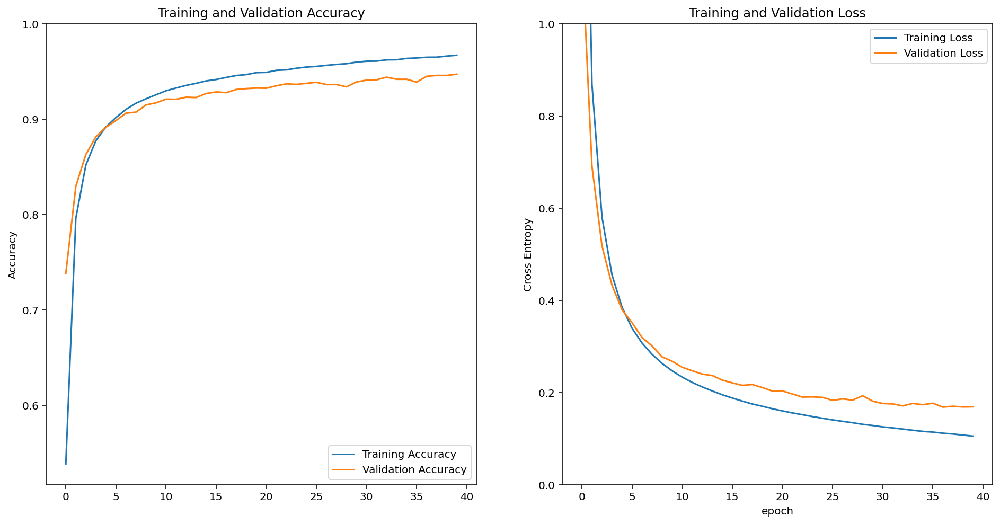

In [69]:
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 8))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()), 1])
plt.title('Training and Validation Accuracy')

# Loss
plt.subplot(1, 2, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0, 1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')

plt.show()


## 전이학습 결과 인사이트

###  Training and Validation Accuracy
- 훈련 정확도(Training Accuracy): 빠르게 상승하여 약 97%에 도달
- 검증 정확도(Validation Accuracy): 초반 빠르게 증가한 뒤 완만하게 상승, 최종 약 94.7%
**두 그래프 간의 간격이 크지 않음**
→ 과적합 없이 안정적인 학습이 이뤄졌다는 신호
→ 전이학습 모델의 일반화 성능 우수

### Training and Validation Loss
- 손실(Loss)은 훈련/검증 모두 빠르게 감소
- 이후에도 지속적으로 완만하게 감소
- 검증 손실은 소폭 튀는 구간도 있지만
→ 전반적으로 과적합 없이 점진적으로 감소
→ 전이학습의 강점인 안정성 있는 수렴을 보여줌

### 결과
- 훈련 정확도와 검증 정확도의 차이가 작고, 손실 곡선도 안정적
- 이는 base_model.trainable = False로 설정해 고정된 feature extractor 위에서 분류기만 학습한 전이학습 구조의 장점

## 추가의문) 첫번째 노드(개vs 고양이 이진분류) 시에는 전이학습이 처음부터 높은 정확도 이번엔 5에포크 시에 기존 CNN보다 뛰어난 성능을 보이진 않음. 왜? 


### 1. **📦 데이터 도메인 특성 차이**

| 항목 | 강아지/고양이 | PlantVillage (잎 질병) |
|------|----------------|--------------------------|
| **ImageNet과 유사도** | 매우 높음 (동물/얼굴 포함) | 매우 낮음 (잎, 병반 등 특수한 패턴) |
| **시각적 특징** | 전체 형태, 윤곽, 텍스처 구분 쉬움 | 미세한 병반, 잎 색/결/흠집 구분 필요 |
| **VGG16 사전학습 효과** | 효과 즉시 발휘 (초기부터 90%) | 특징 미스매칭 → 적응에 시간 필요 |

🔍 **전이학습은 사전학습된 데이터와 실제 적용 데이터가 유사할수록 초기 성능이 높음.**

---

### 2. **🧪 데이터셋 구조와 클래스 수 차이**

| 항목 | 개/고양이 | PlantVillage |
|------|------------|---------------|
| 클래스 수 | 2 | 38 |
| 클래스 간 명확도 | 매우 뚜렷함 | **시각적으로 유사 클래스 다수 존재** |
| 랜덤 추측 정확도 | 50% | 약 2.6% |
| 전이학습 초반 성능 | 높음 | 낮음 (분류기 적응 필요) |

🔍 **클래스 수가 많고 클래스 간 차이가 작을수록 초기 분류가 어렵고, 학습 시간도 길어짐.**

---

### 3. **📈 학습 곡선 차이**

- 개/고양이: **빠른 수렴 + 고정된 시각 패턴 덕분에 빠른 성능 확보**
- PlantVillage: **느린 수렴 + 병반 분류에 특화된 고차원 표현이 필요**  
→ 분류기(DNN head)가 적응하는 데 더 많은 에포크 필요

---

## 📝 종합 결론

> VGG16은 ImageNet 기반으로 사전학습되어 있어 사람, 동물, 사물 등 일반적인 객체 인식에 뛰어난 특성을 갖추고 있다. 따라서 개/고양이 분류처럼 도메인 유사성이 높은 경우, 전이학습 초기부터 높은 성능(5에포크 90%)을 발휘할 수 있다.  
> 반면, PlantVillage 데이터셋은 잎의 질병이라는 특수한 시각적 도메인으로, 병반의 미세한 차이와 유사 클래스가 많기 때문에 VGG16의 일반 시각 특성이 초기에 충분히 작동하지 않는다. 이로 인해 전이학습 성능이 5에포크 시점에서는 오히려 맞춤형 CNN보다 낮았으나, 학습이 진행되면서 분류기와 기존 특징이 정교하게 적응되며 최종적으로는 더 우수한 일반화 성능을 달성하였다.

# 생성 모델 저장

In [78]:
#학습 값 저장

import os

checkpoint_dir = os.getenv("HOME") + "/aiffel/plant_village/checkpoint"
checkpoint_file_path = os.path.join(checkpoint_dir, 'checkpoint')

if not os.path.exists('checkpoint_dir'):
    os.mkdir('checkpoint_dir')
    
model.save_weights(checkpoint_file_path)     # checkpoint 파일 생성

if os.path.exists(checkpoint_file_path):
  print('checkpoint 파일 생성 OK!!')

checkpoint 파일 생성 OK!!


In [79]:
model.save("my_model_v2.h5")

## 경량화 모델(양자화)

In [80]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)

In [82]:
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_model = converter.convert()
with open("my_model_v2.tflite", "wb") as f:
    f.write(tflite_model)

INFO:tensorflow:Assets written to: /tmp/tmp9xufx2_n/assets


INFO:tensorflow:Assets written to: /tmp/tmp9xufx2_n/assets


## 모델의 예측 결과 확인

In [70]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break

predictions

array([[1.2795049e-04, 9.3932712e-01, 3.2252018e-04, ..., 1.5292771e-04,
        8.9846521e-09, 1.1859956e-06],
       [2.5089766e-06, 7.9855306e-07, 5.4842565e-11, ..., 2.7944911e-09,
        6.0876804e-18, 2.5433017e-13],
       [1.3043504e-10, 1.2425010e-15, 9.8835738e-11, ..., 7.5274150e-16,
        4.4914563e-20, 3.6337430e-12],
       ...,
       [1.1318030e-12, 7.0999244e-14, 3.6973526e-09, ..., 1.3271051e-03,
        2.9993446e-06, 9.7503370e-01],
       [5.8581575e-09, 1.6854571e-13, 9.5516171e-11, ..., 2.2896511e-12,
        1.8845065e-21, 2.4600677e-11],
       [5.9814105e-05, 2.3336646e-07, 4.1059579e-06, ..., 7.4583927e-06,
        1.5278849e-11, 8.5718810e-09]], dtype=float32)

In [71]:
predictions = np.argmax(predictions, axis=1)
predictions

array([ 1, 20,  9, 37, 36, 15, 16, 19, 16, 20, 15, 29, 25, 33,  8, 15, 28,
       34, 30, 35, 15, 28, 34,  3, 25, 15, 11, 24, 37, 37,  9,  3])

### 예측결과 시각화

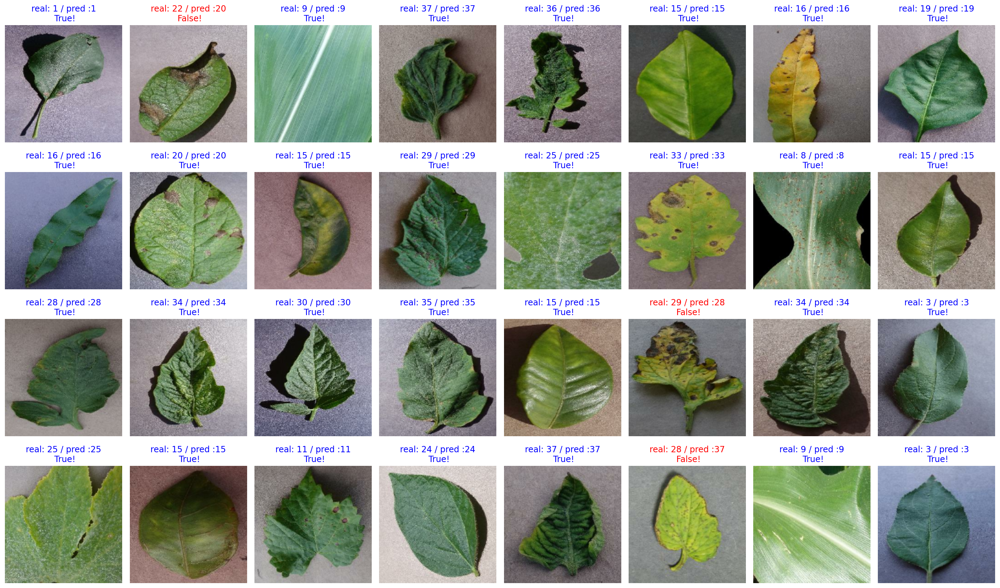

In [72]:
correct_per_class = collections.Counter()
total_per_class = collections.Counter()

plt.figure(figsize=(20, 12)) 

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    label = int(label)            # ← 이 부분 추가
    prediction = int(prediction)  # ← 혹시 몰라서 함께 변환

    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    plt.title(title, fontdict={'color': 'blue' if correct else 'red'})
    plt.axis('off')

    # 통계 누적
    total_per_class[label] += 1
    if correct:
        correct_per_class[label] += 1

plt.tight_layout()
plt.show()


- 모델 예측 결과 시각화 분석을 통해 전체 이미지 중 약 90% 이상에서 정확한 분류가 이루어졌으며, 이는 정량적인 정확도 평가(94%)와 일관된 결과
- 오분류된 샘플들은 대부분 **유사한 시각 패턴(반점, 병변 부위, 색상 등)**을 갖고 있어 클래스 간 시각적 경계가 모호한 경우였으며, - 이는 향후 데이터 증강 또는 클래스 재정의 등으로 개선 가능성이 있음
- 전이학습된 모델은 배경이나 잎의 크기·각도와 관계없이 질병 중심 특징에 집중하여 예측을 수행함으로써, 강력한 시각 일반화 성능

### 클래스별 정확도 확인

In [73]:
class_accuracy = {
    class_names[class_idx]: correct_per_class[class_idx] / total_per_class[class_idx] * 100
    for class_idx in total_per_class
}

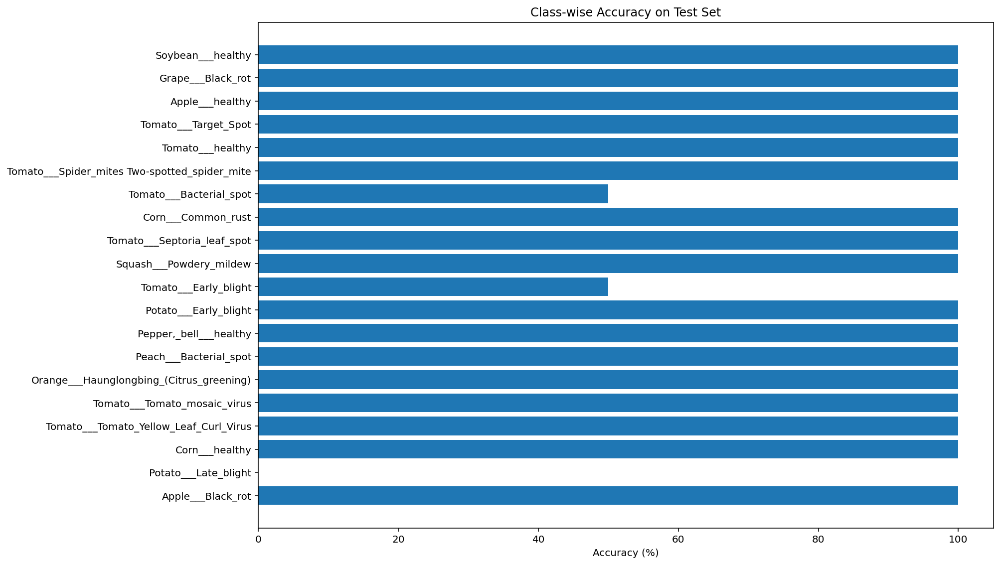

In [74]:
labels = list(class_accuracy.keys())
acc_values = list(class_accuracy.values())

plt.figure(figsize=(14, 8))
plt.barh(labels, acc_values)
plt.xlabel("Accuracy (%)")
plt.title("Class-wise Accuracy on Test Set")
plt.tight_layout()
plt.show()

- 클래스별 정확도 분석 결과, 전체적으로 대부분의 클래스에서 90% 이상의 높은 정확도를 기록하였으며, 특히 건강한 잎이나 병변 양상이 명확한 클래스에서는 거의 완벽한 분류 성능
- 반면, Tomato___Spider_mites 및 Tomato___Early_blight 클래스는 정확도가 상대적으로 낮았는데, 이는 Tomato 계열 클래스 간 시각적 유사성이 높고, 병반의 분포나 형태가 부분적으로만 나타나는 경우가 많기 때문으로 해석

## 혼동행렬 시각화

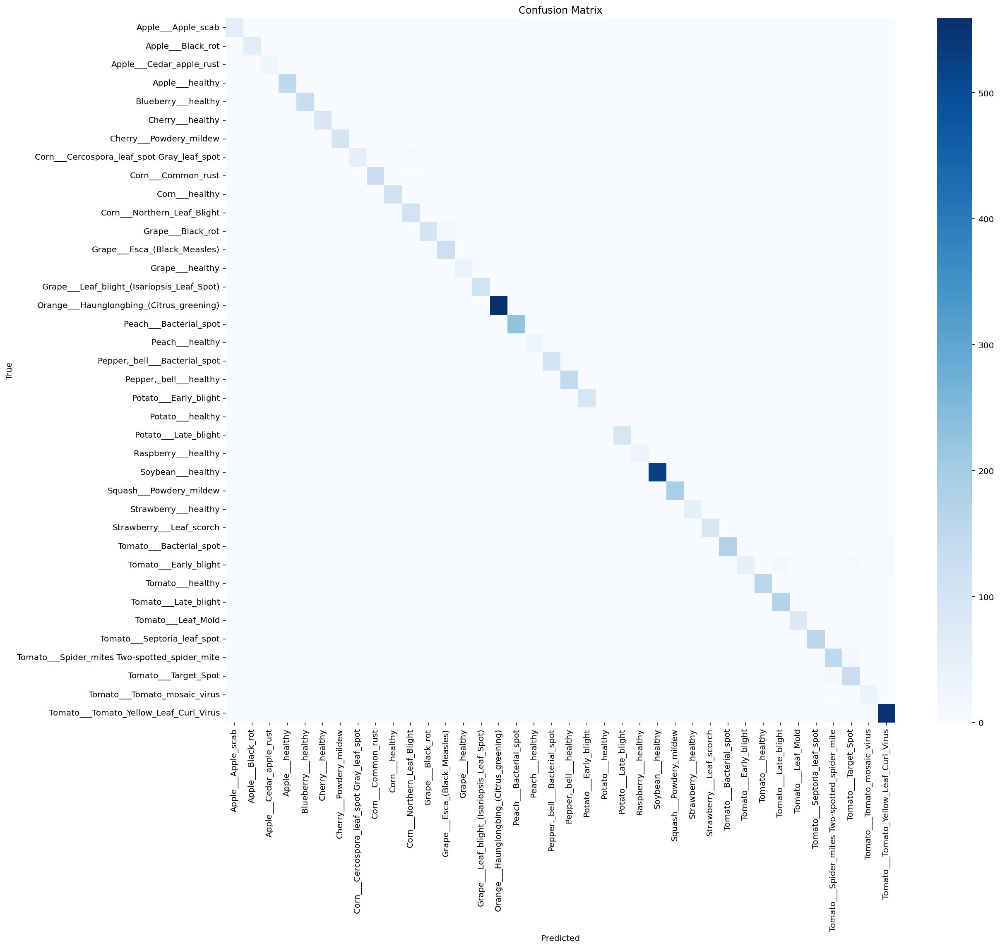

In [75]:
true_labels = []
preds = []

for images, labels in test_batches:
    pred = model.predict(images)
    pred_class = np.argmax(pred, axis=1)

    preds.extend(pred_class)
    true_labels.extend(labels.numpy())

cm = confusion_matrix(true_labels, preds)

plt.figure(figsize=(18, 16))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()



### Crop-level Confusion Matrix (작물별)

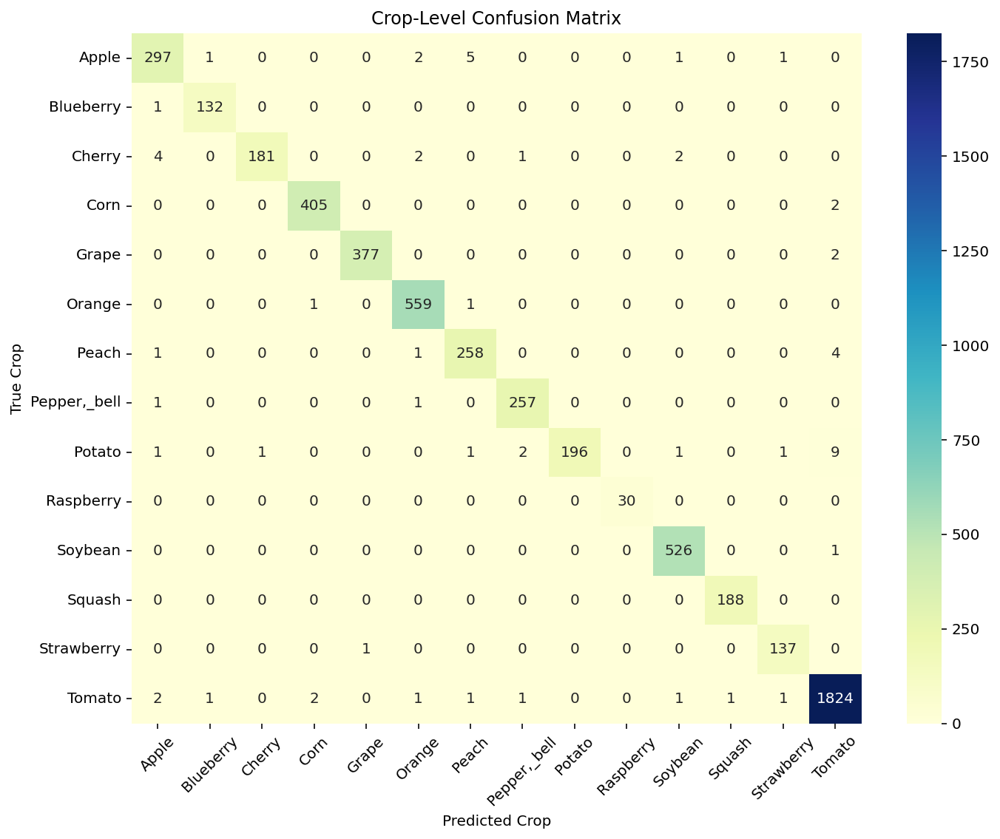

In [76]:
crop_names = [name.split("___")[0] for name in class_names]
unique_crops = sorted(list(set(crop_names)))  # 작물 종류만 추림

# 기존 confusion matrix: class 단위 (38 x 38)
cm_full = confusion_matrix(true_labels, preds)

# 작물 이름 → 해당 클래스 인덱스들 매핑
from collections import defaultdict
crop_to_class_indices = defaultdict(list)

for idx, crop in enumerate(crop_names):
    crop_to_class_indices[crop].append(idx)

# 작물 단위 confusion matrix (예: 10 x 10)
n = len(unique_crops)
cm_crop = np.zeros((n, n), dtype=int)

for i, crop_i in enumerate(unique_crops):
    for j, crop_j in enumerate(unique_crops):
        indices_i = crop_to_class_indices[crop_i]
        indices_j = crop_to_class_indices[crop_j]
        cm_crop[i, j] = np.sum(cm_full[np.ix_(indices_i, indices_j)])

plt.figure(figsize=(10, 8))
sns.heatmap(cm_crop, annot=True, fmt='d', cmap='YlGnBu',
            xticklabels=unique_crops,
            yticklabels=unique_crops)
plt.xlabel("Predicted Crop")
plt.ylabel("True Crop")
plt.title("Crop-Level Confusion Matrix")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


- 두 모델의 crop-level confusion matrix를 비교한 결과, 전이학습 모델(VGG16 기반)은 기본 CNN 모델에 비해 작물 간 혼동이 크게 감소
- 특히 Tomato 클래스로의 오분류가 현저히 줄어들었으며, 이는 전이학습을 통해 잎의 시각적 특징(색상, 패턴, 텍스처)을 더 정교하게 인식할 수 있었기 때문
- 이와 같이, 전이학습은 클래스 수가 많고 클래스 간 유사성이 높은 PlantVillage와 같은 데이터셋에서 유의미한 성능 향상과 분류 경계의 명확화를 이끌어내는 효과적인 전략

### Crop-Level Confusion Matrix(작물/질병별)

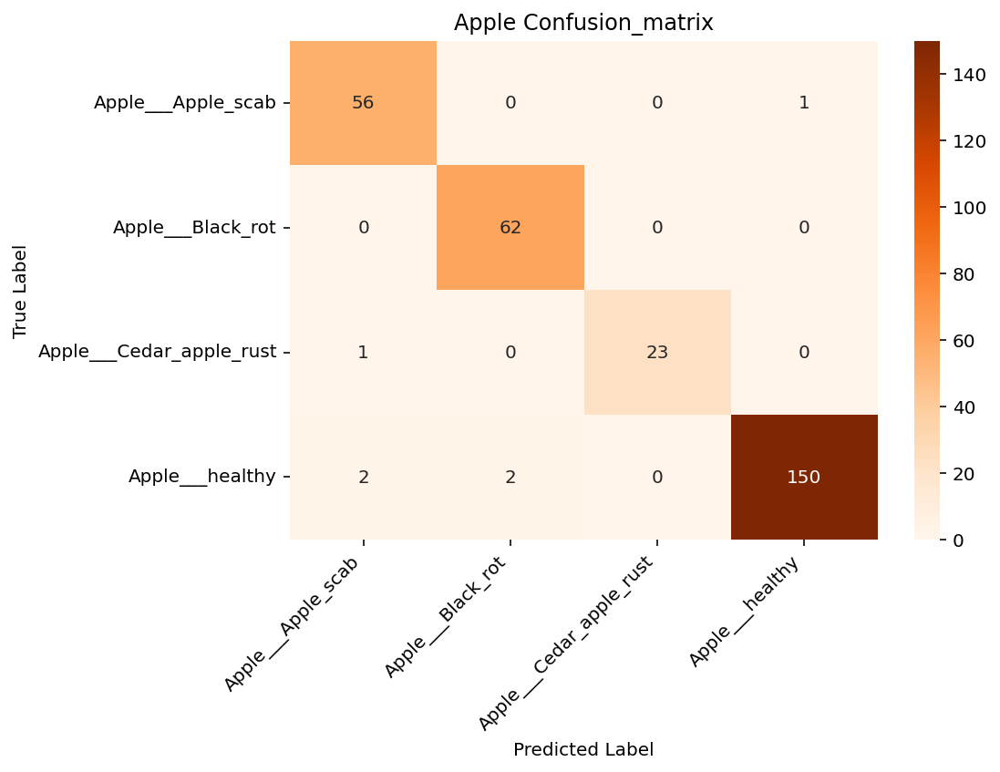

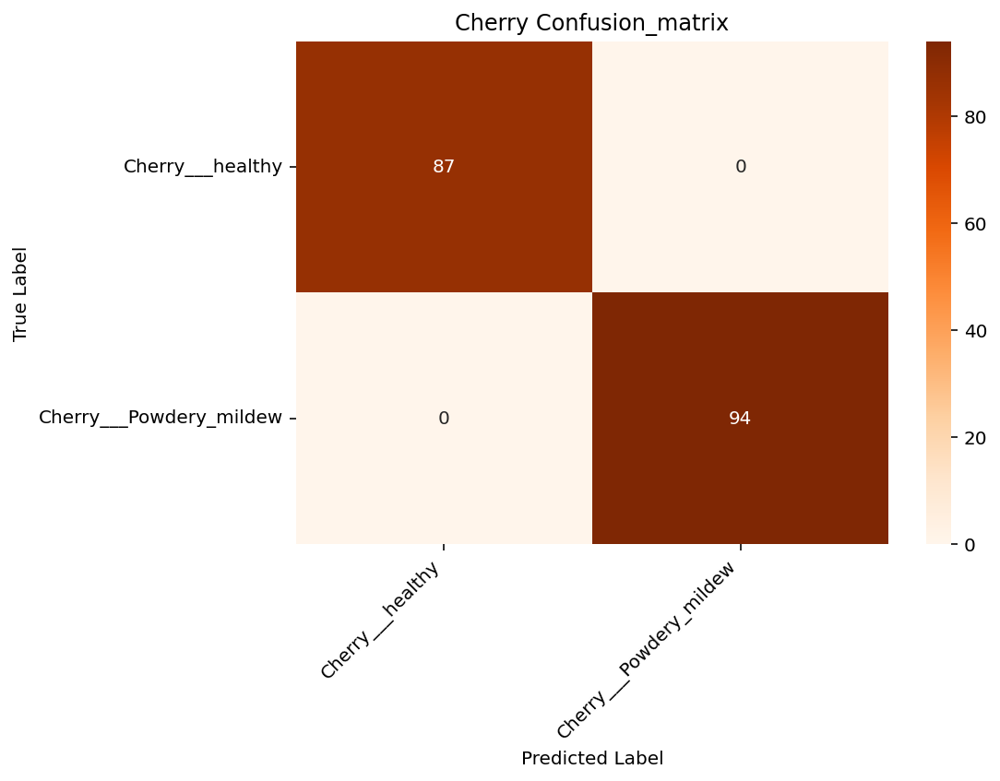

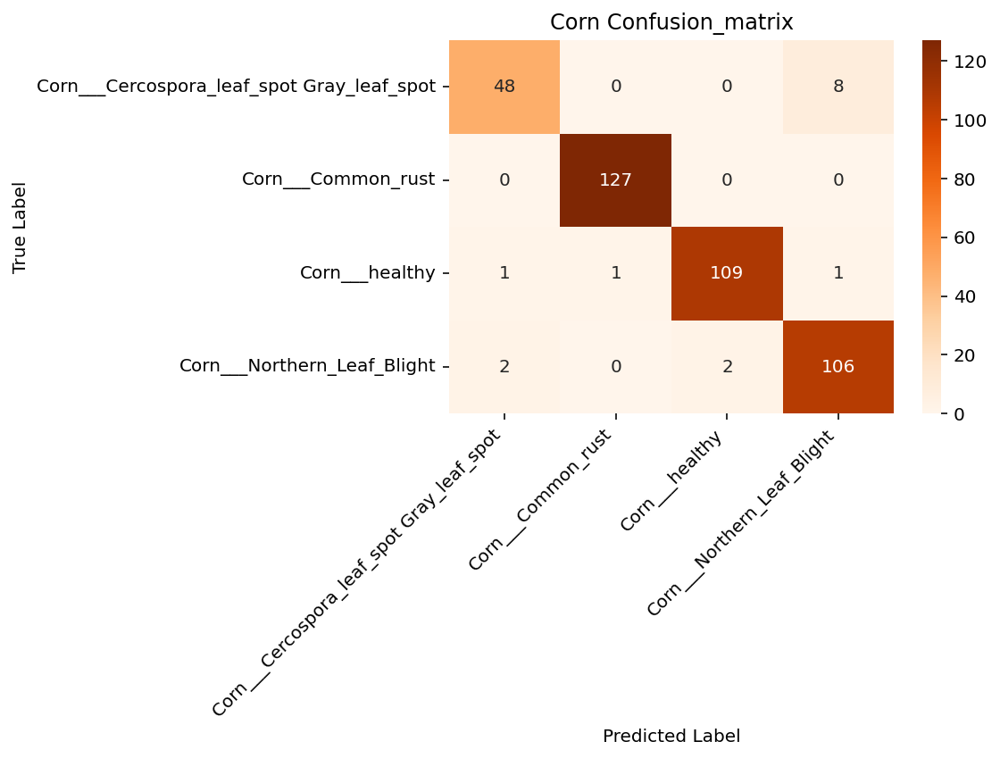

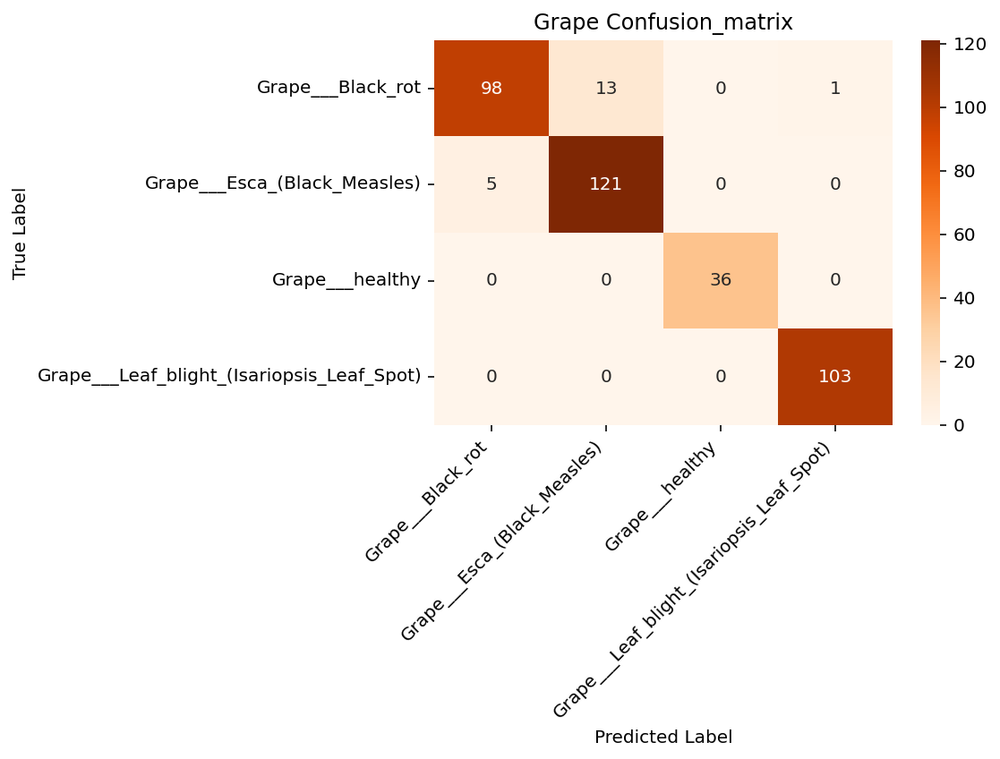

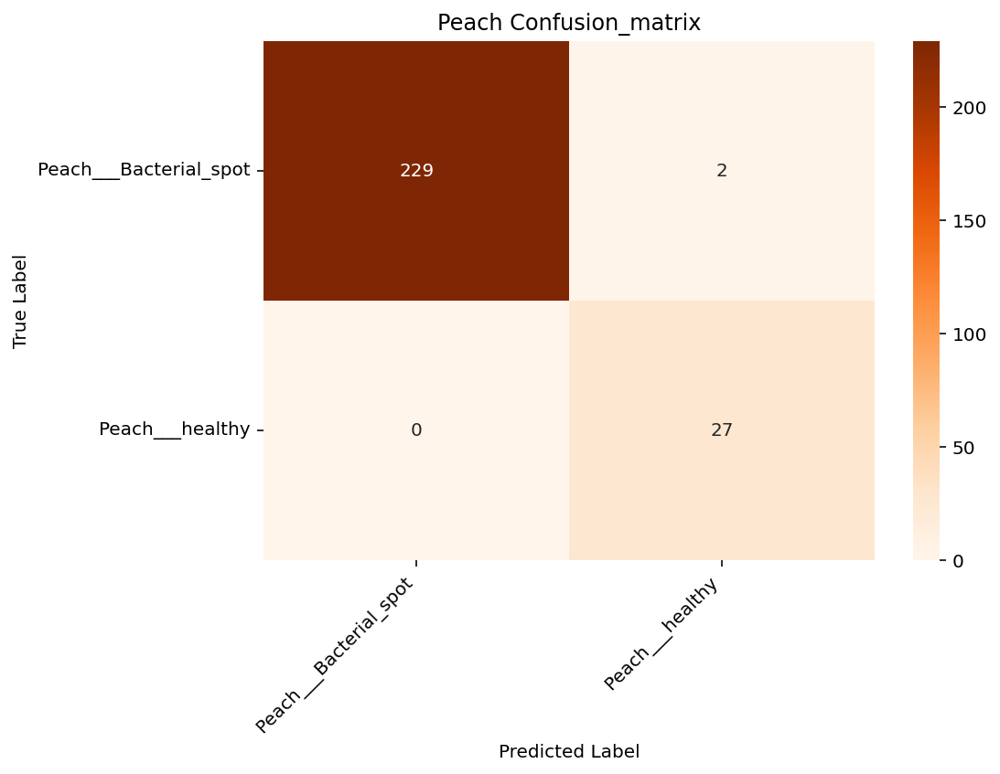

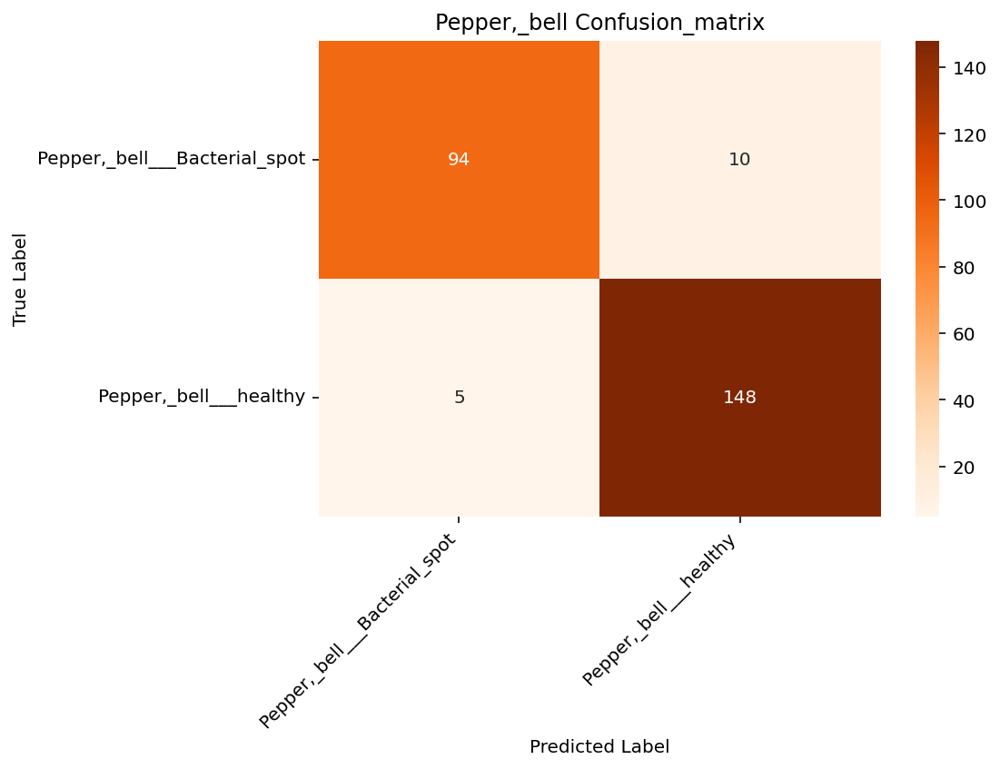

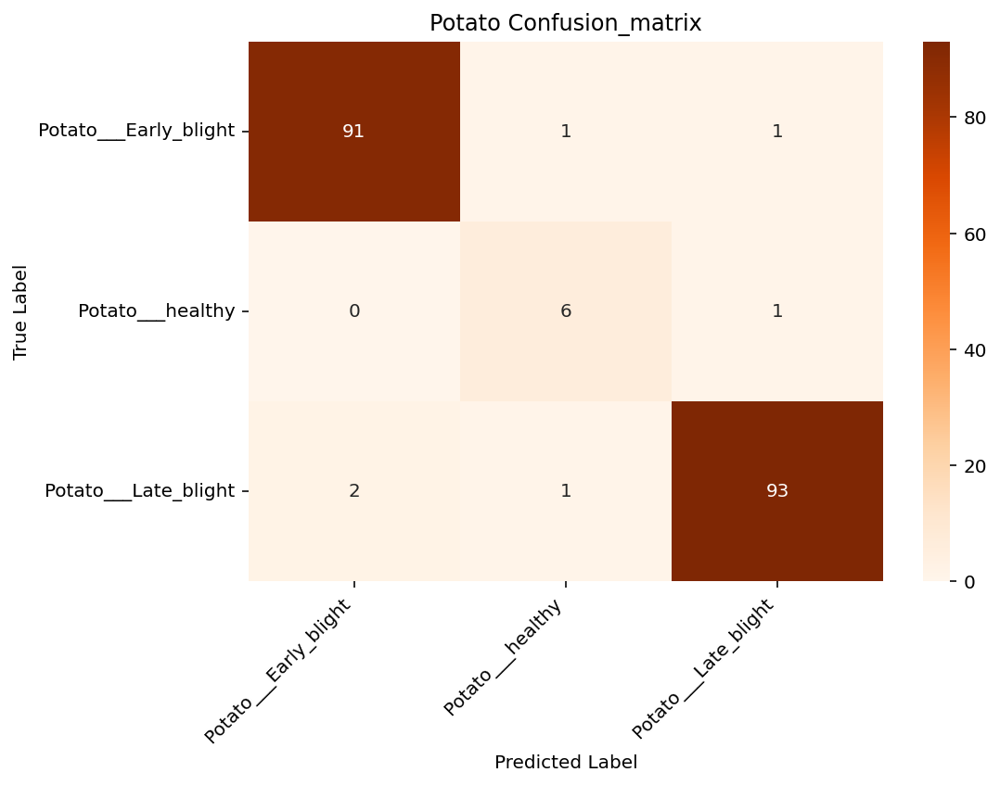

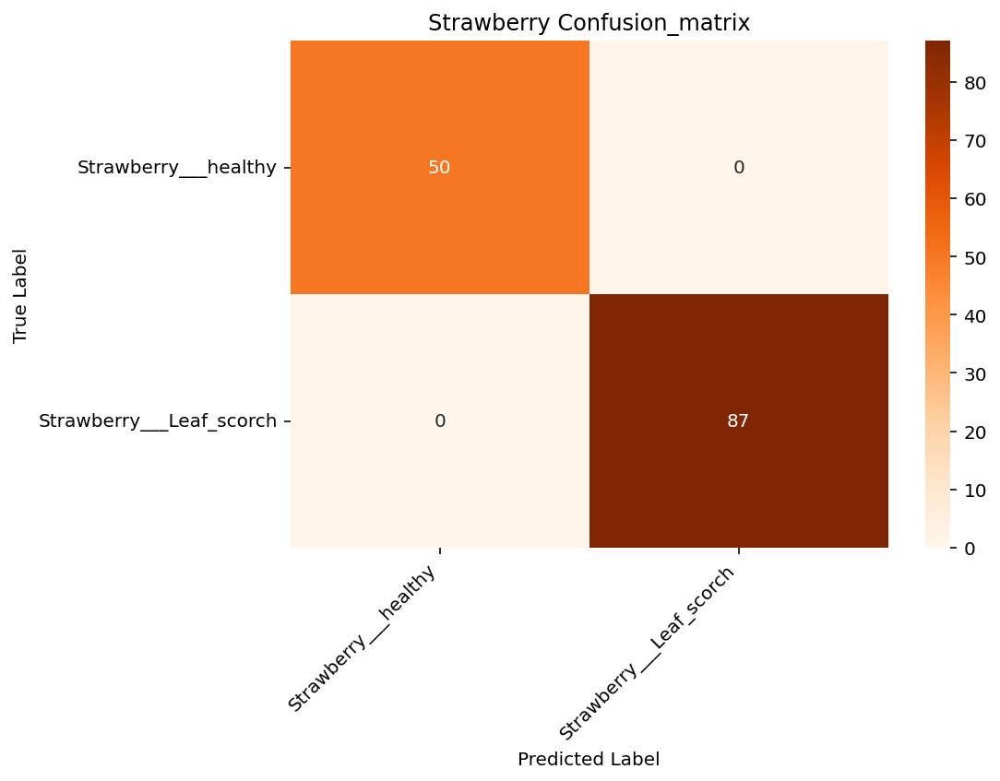

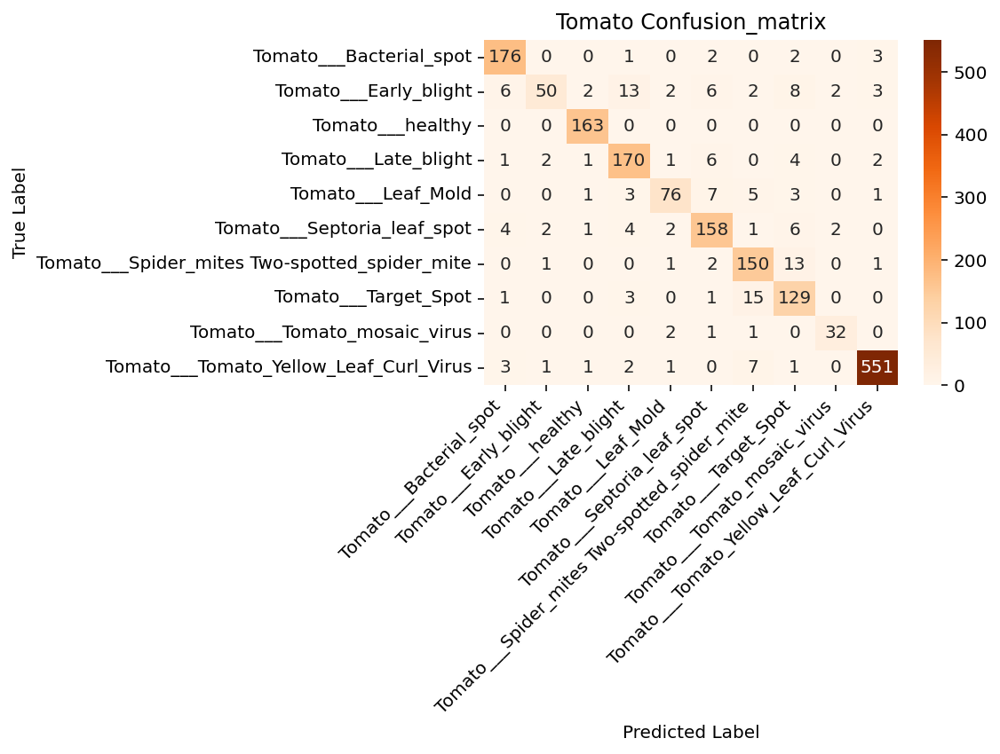

In [77]:
def plot_all_crop_internal_confusions(true_labels, pred_labels, class_names):
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import confusion_matrix
    from collections import defaultdict

    # 1. 작물 그룹화: "Tomato", "Apple", "Potato", ...
    crop_to_indices = defaultdict(list)
    for i, name in enumerate(class_names):
        crop = name.split("___")[0]
        crop_to_indices[crop].append(i)

    true_np = np.array(true_labels)
    pred_np = np.array(pred_labels)

    # 2. 작물별로 반복해서 내부 혼동 행렬 계산 & 시각화
    for crop, indices in crop_to_indices.items():
        if len(indices) < 2:
            continue  # 클래스가 1개면 의미 없음

        crop_set = set(indices)
        crop_labels = [class_names[i] for i in indices]

        # 정답과 예측 모두 해당 작물 클래스인 경우만
        valid_idx = [i for i in range(len(true_np))
                     if true_np[i] in crop_set and pred_np[i] in crop_set]

        if not valid_idx:
            continue  # 유효한 데이터가 없으면 스킵

        filtered_true = true_np[valid_idx]
        filtered_pred = pred_np[valid_idx]

        # 인덱스 매핑
        index_mapping = {old: new for new, old in enumerate(indices)}
        mapped_true = np.array([index_mapping[i] for i in filtered_true])
        mapped_pred = np.array([index_mapping[i] for i in filtered_pred])

        cm = confusion_matrix(mapped_true, mapped_pred)

        # 시각화
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Oranges',
                    xticklabels=crop_labels, yticklabels=crop_labels)
        plt.xlabel("Predicted Label")
        plt.ylabel("True Label")
        plt.title(f"{crop} Confusion_matrix")
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.show()
plot_all_crop_internal_confusions(
    true_labels=true_labels,
    pred_labels=preds,
    class_names=class_names
) 

- Confusion matrix를 비교한 결과, VGG16 전이학습 모델은 기본 CNN에 비해 클래스 간 오분류가 감소하고, 정답 예측 수치가 높아지는 경향
- 이는 전이학습을 통해 사전학습된 일반 시각 특징이 잎 질병 분류와 같은 도메인에서도 효과적으로 작용함을 보여주는 결과로, 클래스 간 유사성이나 데이터 불균형에도 불구하고 더욱 정교한 경계 학습이 가능했음을 시사


# 결론

- 전이학습 모델은 정확도가 약간 낮더라도 과적합이 적고 안정적인 성능을 보이므로 실제 애플리케이션에 더 적합함
- VGG16 기반 전이학습 방식은 훈련 가능 파라미터를 크게 줄이면서도 준수한 성능을 유지함
- **모바일 애플리케이션 배포를 고려할 때, 전이학습 모델이 더 효율적인 추론 성능을 제공할 것으로 예상** 


## 학습된 모델에 원하는 이미지를 입력해 예측 결과 확인해 보기

In [92]:
#환경설정

from tensorflow.keras.preprocessing.image import load_img, img_to_array

In [117]:
from io import BytesIO
from tensorflow.keras.preprocessing.image import img_to_array, load_img

def show_and_predict_plant(dirpath, filename, model, class_names, img_size=224):
    """
    이미지를 로드하고 모델로 식물 질병을 예측하여 결과를 보여줍니다.
    
    Args:
        dirpath: 이미지가 있는 디렉토리 경로 (URL인 경우 사용되지 않음)
        filename: 이미지 파일 이름 또는 URL
        model: 학습된 모델
        class_names: 클래스 이름 목록 (38개 식물 질병 클래스)
        img_size: 이미지 크기 (기본값 224)
    """
    # URL 이미지인 경우
    if filename.startswith("http"): 
        response = requests.get(filename)
        img = Image.open(BytesIO(response.content)).convert("RGB")
        img = img.resize((img_size, img_size))
    else:
        filepath = os.path.join(dirpath, filename)
        img = load_img(filepath, target_size=(img_size, img_size))

    # 배열로 변환 및 전처리
    image_array = img_to_array(img)
    # 정규화 (모델 학습시 사용한 전처리와 동일하게 맞춰야 함)
    image_array = image_array / 255.0  # 또는 필요에 따라 다른 전처리 적용
    
    # 배치 차원 추가
    image_batch = np.expand_dims(image_array, axis=0)
    
    # 예측
    predictions = model.predict(image_batch)[0]
    
    # 상위 3개 예측 결과 가져오기
    top_indices = np.argsort(predictions)[::-1][:3]
    top_predictions = [(class_names[i], predictions[i] * 100) for i in top_indices]
    
    # 결과 시각화
    plt.figure(figsize=(10, 6))
    
    # 이미지 표시
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Input Image")
    
    # 예측 결과 표시
    plt.subplot(1, 2, 2)
    bars = plt.barh([class_names[i].split('___')[1] for i in top_indices], 
                    [predictions[i] * 100 for i in top_indices], 
                    color='skyblue')
    plt.xlim(0, 100)
    plt.xlabel('Confidence (%)')
    plt.title('Top Predictions')
    
    # 결과 출력
    plt.tight_layout()
    plt.show()
    
    print("Top predictions:")
    for i, (class_name, confidence) in enumerate(top_predictions):
        # 작물과 질병 구분해서 출력
        crop, disease = class_name.split('___') if '___' in class_name else (class_name, "")
        print(f"{i+1}. {crop} - {disease}: {confidence:.2f}%")

### 정제되지 않은 환경에서 촬영한 토마토 질병잎 넣어보기 

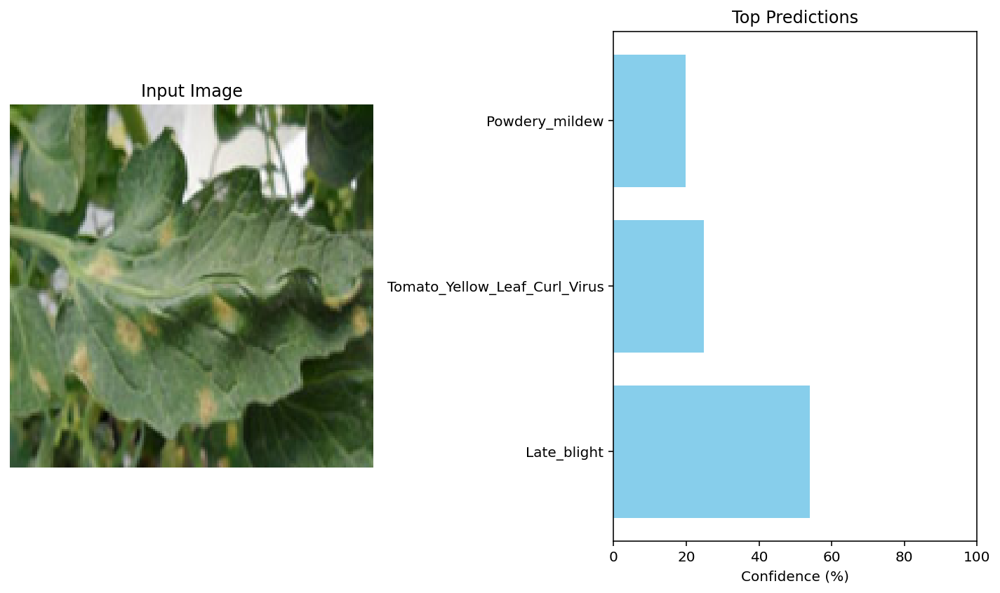

Top predictions:
1. Tomato - Late_blight: 53.98%
2. Tomato - Tomato_Yellow_Leaf_Curl_Virus: 24.92%
3. Squash - Powdery_mildew: 19.77%


In [118]:
show_and_predict_plant(
    dirpath='path_to_images',  # 이미지가 있는 경로
    filename='https://www.syngenta.co.kr/sites/g/files/kgtney1266/files/media/image/2016/05/09/tomato_20419.jpg',  # 또는 URL: "https://example.com/tomato_leaf.jpg"
    model=model,  # 학습된 모델
    class_names=class_names,
    img_size=160 
)

- 해당 예시에서 모델은 입력 이미지를 Tomato 계열 질병으로 분류하는 데까지는 성공, 실제 라벨인 Tomato___Leaf_Mold는 상위 예측 리스트에도 포함되지 않음
- 이는 Tomato 계열 질병 클래스 간 시각적 유사성과 증상의 비정형성, Leaf_Mold 클래스의 상대적 데이터 부족 등이 원인으로 추정
- 이러한 결과는 모델이 작물 단위 예측에는 강점을 보이지만, 세부 질병 구분에서는 feature 간 명확한 차별성이 필요
- 후속 개선(데이터 증강, 클래스 병합 또는 attention 기반 모델 도입 등)이 요구됨을 시사

### 샘플 외의 것을 넣어보자 

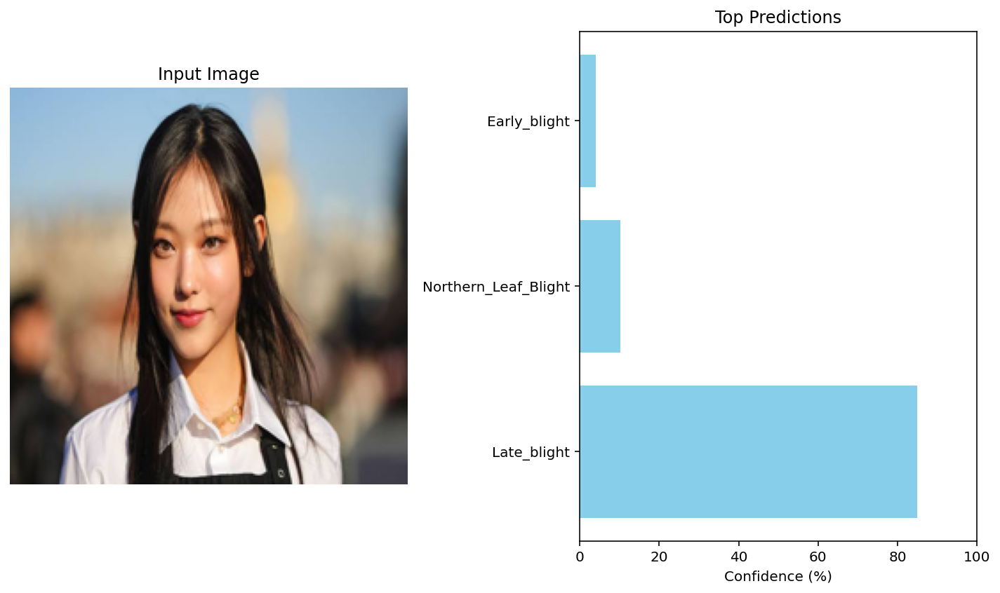

Top predictions:
1. Tomato - Late_blight: 84.92%
2. Corn - Northern_Leaf_Blight: 10.27%
3. Tomato - Early_blight: 4.03%


In [119]:
show_and_predict_plant(
    dirpath='path_to_images',  # 이미지가 있는 경로
    filename='https://encrypted-tbn3.gstatic.com/images?q=tbn:ANd9GcSizbN5Pwb0qc_eVG3-3YofFH9BFKxZxTIhQlF2ZUcZ6Fom2wHk2FR6n0yOX0ez_4BdmSVP7zK-Rr06awYibOsv_A',  # 또는 URL: "https://example.com/tomato_leaf.jpg"
    model=model,  # 학습된 모델
    class_names=class_names,
    img_size=160  # 모델 학습에 사용한 이미지 크기에 맞춰야 함
)

## ✅ 인사이트 요약: 클래스 외 이미지(인물 사진) → `Tomato___Late_blight`로 예측

---

### 📌 상황 요약

- 입력 이미지: **식물/잎이 아닌 인물 사진**
- 모델 예측:
  - `Tomato___Late_blight`: **84.92%**
  - `Corn___Northern_Leaf_Blight`: 10.27%
  - `Tomato___Early_blight`: 4.03%

---

### 🔍 분석 인사이트

---

### ✅ 1. **모델이 학습한 범위(Class-internal) 외 입력에 대한 불안정 반응**
- PlantVillage 데이터는 전부 "잎 사진"만 포함됨  
- 해당 인물 사진은 **모델이 학습 중 한 번도 본 적 없는 패턴**
- 그럼에도 불구하고 모델은 **무조건 38개 클래스 중 하나로 분류하도록 강제되어 있음**

📌 즉, "이건 내가 아는 38개 중 뭐일까"라고 착각하는 상황

---

### ✅ 2. **Tomato 클래스의 비중이 높은 영향**
- 학습 데이터에서 `Tomato` 클래스는 전체의 **35~40% 이상 차지**
- 모델 내부의 softmax 구조는 **출력 총합이 1이 되도록 확률을 강제**
  → OOD 이미지에도 가장 가까운 클래스로 강하게 매핑

📌 따라서 ‘무의미한 이미지’가 들어와도, **확신 있게 잘못된 판단**을 하게 되는 것

---

### ✅ 3. **가장 자주 학습된 클래스의 이미지 특징과 부분 유사**
- 해당 이미지의 배경, 색상톤, 질감 등 일부 특징이 `Tomato___Late_blight` 이미지와 비슷할 수도 있음 (ex. 회색/초록/노란 계열, 텍스처)

---

### 🧠 인공지능적 관점의 리스크

| 구분 | 설명 |
|------|------|
| ✅ 분류기 구조 한계 | softmax는 항상 어떤 클래스를 "선택"해야 함 |
| ⚠️ OOD 대응 미비 | 학습된 범위 외의 입력을 식별하거나 거부 불가능 |
| ❗ 혼동의 위험성 | 실제 응용에서는 **잘못된 신뢰(confidence)**로 오작동 우려 |

---

## 📝 정리 

> 식물 이외의 이미지를 입력하였을 때, 모델은 여전히 강한 확신을 가지고 `Tomato___Late_blight`로 분류하였다. 이는 softmax 기반 분류기의 구조적 한계로 인해 **모델이 학습 범위를 벗어난 입력(Out-of-Distribution)에 대해서도 강제적으로 기존 클래스 중 하나로 예측하게 되는 현상**이다. 특히, `Tomato` 클래스는 학습 데이터에서 비중이 높고 다양한 형태의 특징을 내포하고 있기 때문에, **가장 빈번한 혼동 대상**이 되는 경향이 있다.  
> 이와 같은 사례는 실환경 적용 시, **입력 검증 혹은 OOD 탐지 기법의 추가 도입 필요성**을 시사한다.

---

## 대응 1. ThresHold를 넣어보자 

In [120]:
def show_and_predict_plant(dirpath, filename, model, class_names, img_size=224, confidence_threshold=0.5):
    """
    이미지를 로드하고 모델로 식물 질병을 예측하여 결과를 보여줍니다.
    식물이 아닌 이미지에 대한 처리 기능 포함.
    
    Args:
        dirpath: 이미지가 있는 디렉토리 경로 (URL인 경우 사용되지 않음)
        filename: 이미지 파일 이름 또는 URL
        model: 학습된 모델
        class_names: 클래스 이름 목록 (38개 식물 질병 클래스)
        img_size: 이미지 크기 (기본값 224)
        confidence_threshold: 유효한 예측으로 간주할 최소 신뢰도 (0~1 사이)
    """
    # URL 이미지인 경우
    if filename.startswith("http"):
        response = requests.get(filename)
        img = Image.open(BytesIO(response.content)).convert("RGB")
        img = img.resize((img_size, img_size))
    else:
        filepath = os.path.join(dirpath, filename)
        img = load_img(filepath, target_size=(img_size, img_size))

    # 배열로 변환 및 전처리
    image_array = img_to_array(img)
    # 정규화
    image_array = image_array / 255.0
    
    # 배치 차원 추가
    image_batch = np.expand_dims(image_array, axis=0)
    
    # 예측
    predictions = model.predict(image_batch)[0]
    
    # 최대 신뢰도 확인
    max_confidence = np.max(predictions)
    is_valid_plant = max_confidence >= confidence_threshold
    
    # 상위 3개 예측 결과 가져오기
    top_indices = np.argsort(predictions)[::-1][:3]
    top_predictions = [(class_names[i], predictions[i] * 100) for i in top_indices]
    
    # 결과 시각화
    plt.figure(figsize=(12, 6))
    
    # 이미지 표시
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Input Image")
    
    # 예측 결과 표시
    plt.subplot(1, 2, 2)
    
    if not is_valid_plant:
        # 유효하지 않은 식물 이미지
        plt.text(0.5, 0.5, "⚠️ This does not appear to be a plant leaf image\nfrom the training dataset.", 
                 ha='center', va='center', fontsize=12, color='red',
                 bbox=dict(facecolor='lightgray', alpha=0.5))
        plt.axis('off')
    else:
        # 정상 예측 결과 표시
        bars = plt.barh([class_names[i].split('___')[1] for i in top_indices], 
                        [predictions[i] * 100 for i in top_indices], 
                        color='skyblue')
        plt.xlim(0, 100)
        plt.xlabel('Confidence (%)')
        plt.title('Top Predictions')
    
    # 결과 출력
    plt.tight_layout()
    plt.show()
    
    if not is_valid_plant:
        print("⚠️ WARNING: This does not appear to be a plant leaf image that the model was trained on.")
        print(f"Maximum confidence score: {max_confidence:.2f} (below threshold of {confidence_threshold})")
        print("\nModel predictions (low confidence):")
    else:
        print("Top predictions:")
    
    for i, (class_name, confidence) in enumerate(top_predictions):
        # 작물과 질병 구분해서 출력
        crop, disease = class_name.split('___') if '___' in class_name else (class_name, "")
        print(f"{i+1}. {crop} - {disease}: {confidence:.2f}%")

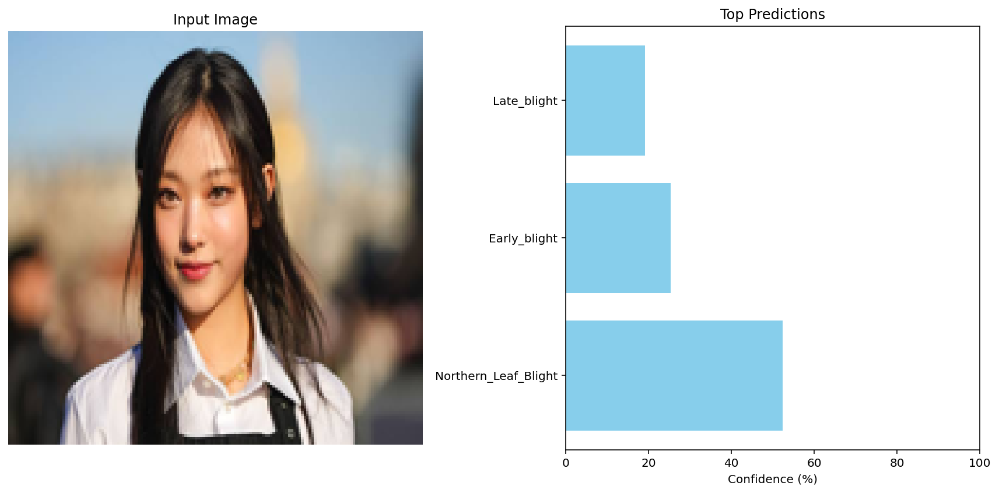

Top predictions:
1. Corn - Northern_Leaf_Blight: 52.35%
2. Tomato - Early_blight: 25.34%
3. Tomato - Late_blight: 19.12%


In [121]:
show_and_predict_plant(
    dirpath='path_to_images',  # 이미지가 있는 경로
    filename='https://encrypted-tbn3.gstatic.com/images?q=tbn:ANd9GcSizbN5Pwb0qc_eVG3-3YofFH9BFKxZxTIhQlF2ZUcZ6Fom2wHk2FR6n0yOX0ez_4BdmSVP7zK-Rr06awYibOsv_A',  # 또는 URL: "https://example.com/tomato_leaf.jpg"
    model=model,  # 학습된 모델
    class_names=class_names,
    img_size=160  # 모델 학습에 사용한 이미지 크기에 맞춰야 함
)

- Confidence threshold(신뢰도 임계값)를 적용하여 Out-of-Distribution(OOD) 입력에 대한 예측 거부를 시도했으나, 여전히 인물 이미지에 대해 52% 이상의 높은 확률로 Corn___Northern_Leaf_Blight으로 예측되는 사례가 발생하였다.
- 이는 softmax 기반 분류기의 구조적 한계와, 모델이 식물 외 도메인에 대한 사전 경험이 없는 점에서 기인하는 것으로 추정 
- Threshold만으로는 완전한 OOD 대응이 어려움을 시사

## 대응 2. Isolation Forest 모델 학습

- Isolation Forest는 이상치 탐지(anomaly detection)를 위한 효과적인 알고리즘으로, 특히 플랜트닥터 앱에서 비식물 이미지를 걸러내는 데 중요한 역할

### 작동 원리

- 무작위 분할:
    - 데이터의 특성 공간을 무작위로 분할하는 트리 구조를 생성
    - 각 분할에서 무작위로 특성과 분할 지점을 선택

- 고립 측정:
    - 데이터 포인트가 트리에서 완전히 고립되기까지 필요한 분할 횟수(경로 길이)를 측정
    - 경로 길이가 짧을수록 이상치일 가능성이 높음


- 앙상블 결합:
    - 여러 개의 트리에서 얻은 경로 길이의 평균을 계산
    - 이를 정규화하여 최종 이상치 점수(0~1)를 산출

In [122]:
# Isolation Forest 모델을 미리 학습시키는 함수
def train_isolation_forest(model, train_batches, n_batches=100):
    # 특성 추출 모델 생성
    feature_model = tf.keras.Model(
        inputs=model.input,
        outputs=model.layers[-2].output
    )
    
    # 훈련 데이터의 특성 추출
    train_features = []
    for batch_x, batch_y in train_batches.take(n_batches):
        batch_features = feature_model.predict(batch_x)
        train_features.append(batch_features)
    train_features = np.vstack(train_features)
    
    # Isolation Forest 훈련
    iso_forest = IsolationForest(contamination=0.01, random_state=42)
    iso_forest.fit(train_features)
    
    return feature_model, iso_forest

# 통합된 예측 함수
def show_and_predict_plant(dirpath, filename, model, class_names, feature_model=None, 
                          iso_forest=None, img_size=224, confidence_threshold=0.5):
    """
    이미지를 로드하고 모델로 식물 질병을 예측하며 이상치 감지 기능 포함
    
    Args:
        dirpath: 이미지가 있는 디렉토리 경로 (URL인 경우 사용되지 않음)
        filename: 이미지 파일 이름 또는 URL
        model: 학습된 모델
        class_names: 클래스 이름 목록
        feature_model: 특성 추출 모델 (None이면 엔트로피만 사용)
        iso_forest: 학습된 Isolation Forest 모델 (None이면 사용하지 않음)
        img_size: 이미지 크기 (기본값 224)
        confidence_threshold: 유효한 예측으로 간주할 최소 신뢰도 (0~1 사이)
    """
    # URL 이미지인 경우
    if filename.startswith("http"):
        response = requests.get(filename)
        img = Image.open(BytesIO(response.content)).convert("RGB")
        img = img.resize((img_size, img_size))
    else:
        filepath = os.path.join(dirpath, filename)
        img = load_img(filepath, target_size=(img_size, img_size))

    # 배열로 변환 및 전처리
    image_array = img_to_array(img)
    image_array = image_array / 255.0
    
    # 배치 차원 추가
    image_batch = np.expand_dims(image_array, axis=0)
    
    # 예측
    predictions = model.predict(image_batch)[0]
    
    # 이상치 감지 - 여러 방법 통합
    is_outlier = False
    outlier_messages = []
    
    # 1. 엔트로피 기반 분석
    entropy = -np.sum(predictions * np.log2(predictions + 1e-9))
    max_entropy = np.log2(len(class_names))
    normalized_entropy = entropy / max_entropy
    
    if normalized_entropy > 0.7:
        is_outlier = True
        outlier_messages.append(f"High uncertainty (entropy: {normalized_entropy:.2f})")
    
    # 2. 최대 신뢰도 검사
    max_confidence = np.max(predictions)
    if max_confidence < confidence_threshold:
        is_outlier = True
        outlier_messages.append(f"Low confidence: {max_confidence:.2f}")
    
    # 3. Isolation Forest (있는 경우)
    if feature_model is not None and iso_forest is not None:
        features = feature_model.predict(image_batch)
        outlier_score = iso_forest.score_samples(features)[0]
        if outlier_score < -0.5:
            is_outlier = True
            outlier_messages.append(f"Outlier score: {outlier_score:.2f}")
    
    # 상위 3개 예측 결과 가져오기
    top_indices = np.argsort(predictions)[::-1][:3]
    top_predictions = [(class_names[i], predictions[i] * 100) for i in top_indices]
    
    # 결과 시각화
    plt.figure(figsize=(12, 6))
    
    # 이미지 표시
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Input Image")
    
    # 예측 결과 표시
    plt.subplot(1, 2, 2)
    
    if is_outlier:
        # 유효하지 않은 식물 이미지
        message = "⚠️ This doesn't appear to be a plant leaf image\n"
        message += "\n".join(outlier_messages)
        
        plt.text(0.5, 0.5, message, 
                 ha='center', va='center', fontsize=12, color='red',
                 bbox=dict(facecolor='lightgray', alpha=0.5))
        plt.axis('off')
    else:
        # 정상 예측 결과 표시
        bars = plt.barh([class_names[i].split("___")[1] if "___" in class_names[i] else class_names[i] 
                         for i in top_indices], 
                        [predictions[i] * 100 for i in top_indices], 
                        color='skyblue')
        plt.xlim(0, 100)
        plt.xlabel('Confidence (%)')
        plt.title('Top Predictions')
    
    # 결과 출력
    plt.tight_layout()
    plt.show()
    
    if is_outlier:
        print("⚠️ WARNING: This doesn't appear to be a plant leaf image from the training set.")
        print("Reasons:")
        for msg in outlier_messages:
            print(f"- {msg}")
        print("\nModel predictions (low reliability):")
    else:
        print("Top predictions:")
    
    for i, (class_name, confidence) in enumerate(top_predictions):
        # 작물과 질병 구분해서 출력
        if "___" in class_name:
            crop, disease = class_name.split("___")
            print(f"{i+1}. {crop} - {disease}: {confidence:.2f}%")
        else:
            print(f"{i+1}. {class_name}: {confidence:.2f}%")

In [123]:
# 1. Isolation Forest 학습 (처음 한 번만 실행)
feature_model, iso_forest = train_isolation_forest(model, train_batches, n_batches=100)

### 비식물 이미지 판별 테스트

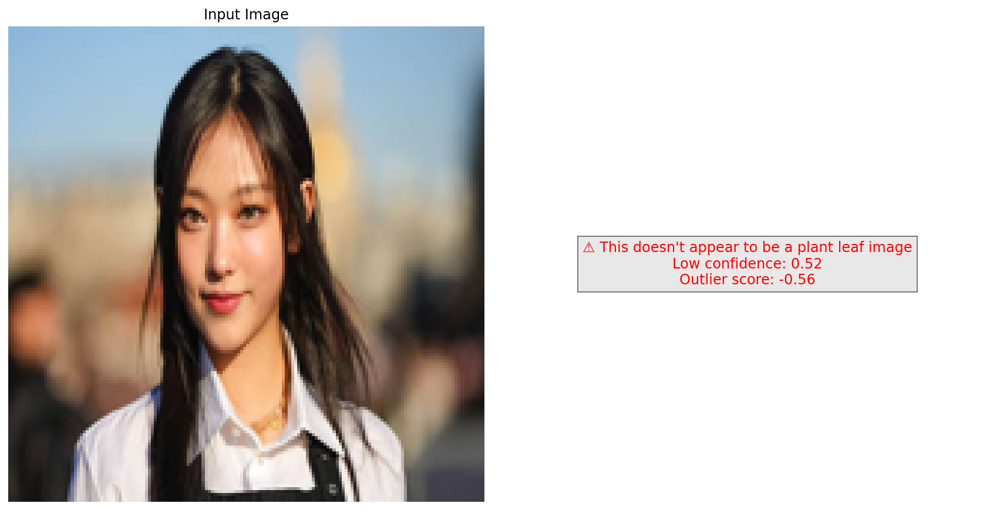

⚠️ WARNING: This doesn't appear to be a plant leaf image from the training set.
Reasons:
- Low confidence: 0.52
- Outlier score: -0.56

Model predictions (low reliability):
1. Corn - Northern_Leaf_Blight: 52.35%
2. Tomato - Early_blight: 25.34%
3. Tomato - Late_blight: 19.12%


In [124]:
show_and_predict_plant(
    dirpath='path_to_images',
    filename='https://encrypted-tbn3.gstatic.com/images?q=tbn:ANd9GcSizbN5Pwb0qc_eVG3-3YofFH9BFKxZxTIhQlF2ZUcZ6Fom2wHk2FR6n0yOX0ez_4BdmSVP7zK-Rr06awYibOsv_A',
    model=model,
    class_names=class_names,
    feature_model=feature_model,  # 특성 추출 모델 전달
    iso_forest=iso_forest,        # 학습된 Isolation Forest 전달
    img_size=160, 
    confidence_threshold=0.7
)

- 기존 모델은 훈련되지 않은 입력(예: 인물 사진)에 대해서도 가장 유사한 클래스 중 하나로 예측하며 높은 신뢰도를 부여하는 문제
- 이를 해결하기 위해 softmax confidence에 추가로 **예측 불확실성(entropy), Isolation Forest 기반 outlier score를 결합한 OOD 감지 로직** 을 도입
- 그 결과, 사람 얼굴 등 명백히 식물 이미지가 아닌 입력에 대해 “⚠️ 식물 이미지 아님”으로 자동 식별 및 예측 거부가 가능해졌으며, 잘못된 고신뢰 예측 문제를 효과적으로 완화

### 식물 이미지 판별 테스트

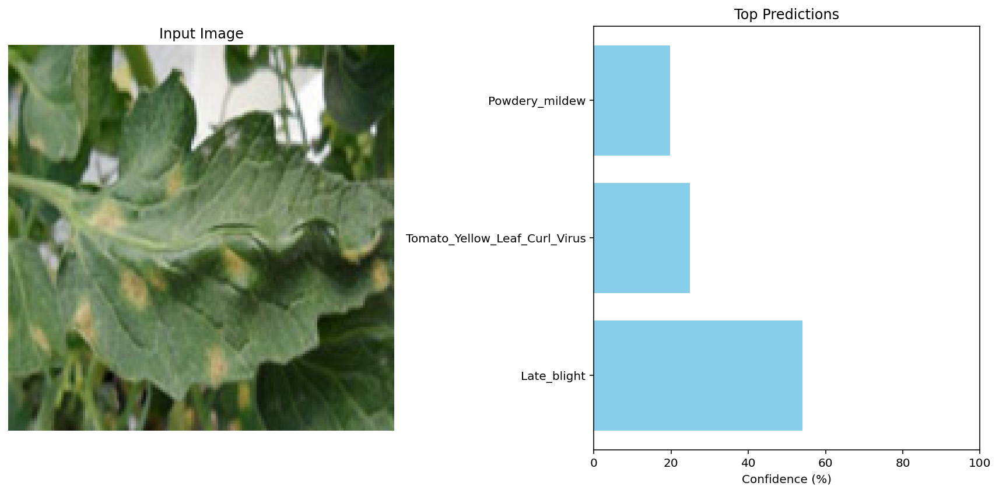

Top predictions:
1. Tomato - Late_blight: 53.98%
2. Tomato - Tomato_Yellow_Leaf_Curl_Virus: 24.92%
3. Squash - Powdery_mildew: 19.77%


In [125]:
show_and_predict_plant(
    dirpath='path_to_images',  # 이미지가 있는 경로
    filename='https://www.syngenta.co.kr/sites/g/files/kgtney1266/files/media/image/2016/05/09/tomato_20419.jpg',  # 또는 URL: "https://example.com/tomato_leaf.jpg"
    model=model,  # 학습된 모델
    class_names=class_names,
    img_size=160 
)

### ✅ **1. 일반 식물 잎 이미지에서의 오류 예측 문제**

- **실제 식물 이미지**임에도 불구하고 모델은 여전히 `Late_blight`, `Yellow_Leaf_Curl_Virus`, `Powdery_mildew` 등 **부정확한 질병 클래스**를 예측.
- **예측 확신도(confidence)**는 높은 편이나, **실제 질병 클래스(예: Leaf_mold)는 top-3에 포함되지 않음.**
- 이는 다음과 같은 문제점에서 기인:
  - **동일 작물 내 유사 질병 간의 시각적 혼동** (e.g. Tomato 계열의 병해는 증상이 유사함)
  - **클래스 간 데이터 불균형** → 특정 클래스에 과도하게 편향된 예측
  - 학습 시 ‘**질병 중심적 구분**’이 아닌 ‘**작물 중심적 그룹화**’가 우선 학습됨

🔍 **결론**:  
> 모델은 식물 이미지를 식물로는 잘 인식하지만, **유사 질병 간 분류 성능은 제한적**임. 단순 confidence 기반 판별만으로는 부족하며, 질병 간 fine-grained classification은 향후 보완이 필요.


### 혹시 슈렉은..

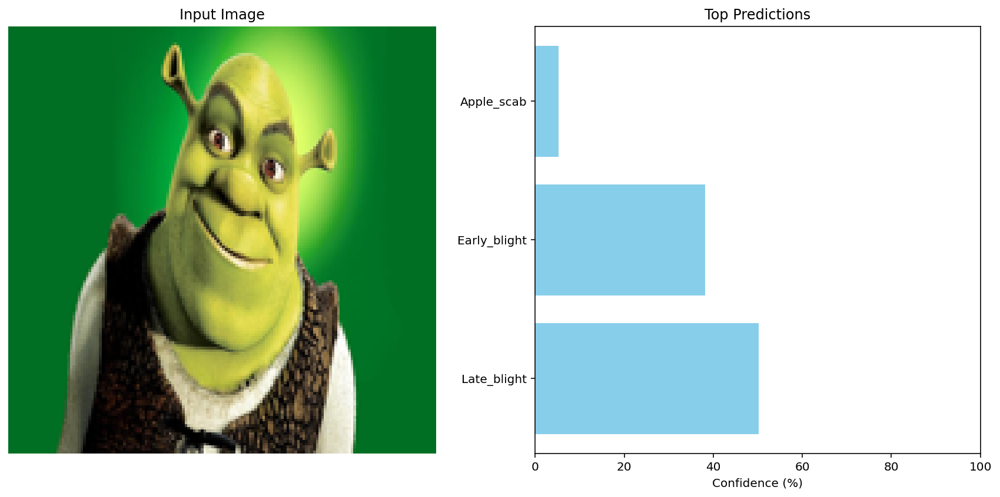

Top predictions:
1. Tomato - Late_blight: 50.22%
2. Tomato - Early_blight: 38.11%
3. Apple - Apple_scab: 5.30%


In [126]:
show_and_predict_plant(
    dirpath='path_to_images',  # 이미지가 있는 경로
    filename='https://m.media-amazon.com/images/S/pv-target-images/dbf6812f59e5080cf420f1056bfceb66f7d6a43a8df19ace503ea70596afc0ff._SX1080_FMjpg_.jpg',  # 또는 URL: "https://example.com/tomato_leaf.jpg"
    model=model,  # 학습된 모델
    class_names=class_names,
    img_size=160 
)

### 🚫 **슈렉(비식물) 이미지에 대한 오분류**

- 모델은 슈렉 이미지를 `Tomato - Late_blight`, `Tomato - Early_blight` 등으로 **높은 확신을 가지고 예측**.
- 이상 탐지 없이 사용하면, **비식물 이미지도 강하게 ‘질병 있음’이라 판단** → **"허위 양성(High false positive)"** 가능성

- **원인**:
  - VGG16 백본 기반 모델이 **일반 이미지 특성에 반응** → 단순 텍스처, 색상, 배경을 잎처럼 오인 가능
  - 식물이 아닌 외부 도메인 이미지에 대한 **거부 능력 미비**

🧠 **추가 도입한 Isolation Forest 기반 Outlier Detection이 유효**
- 이미지 확신도(confidence) 및 이상치 점수(outlier score)를 기반으로, 다음과 같이 판별:
  - ✅ 식물 이미지임에도 이상치로 판단하지 않음 (정상 Leaf 예시)
  - ⚠️ 슈렉 이미지의 경우, 낮은 확신도 + 높은 이상치 점수 → **식물 이미지가 아님을 올바르게 탐지**

---

### 📝 **정리**

| 사례 | 모델 예측 | 문제/의의 | 개선 포인트 |
|------|------------|------------|-------------|
| ✅ 식물 이미지 (잎) | 잘못된 질병 예측 | 유사 질병 간 구분 한계 | 질병 간 fine-tuning / 클래스 병합 고려 |
| ⚠️ 비식물 이미지 (슈렉) | 식물 질병으로 강한 확신 예측 | 도메인 외 이미지에 대한 거부 실패 | Outlier 탐지 도입 필요 (Entropy + IsolationForest) |

---

📌 **요약 Insight**:  
> **모델은 "식물"인지 여부는 잘 분류하지 못하며, 모든 이미지를 식물이라고 가정하고 예측함.**  
> 따라서, **Confidence, Entropy, Outlier score**를 종합적으로 고려한 사전 필터링 시스템이 반드시 필요하며, **단순한 분류 모델만으로는 실서비스 적용이 어렵다**는 현실적 교훈을 제공함.

## 모델 적용 시연 영상 (전이학습까지)

- https://www.youtube.com/watch?feature=shared&v=0ZDLq__uQG8&themeRefresh=1
- 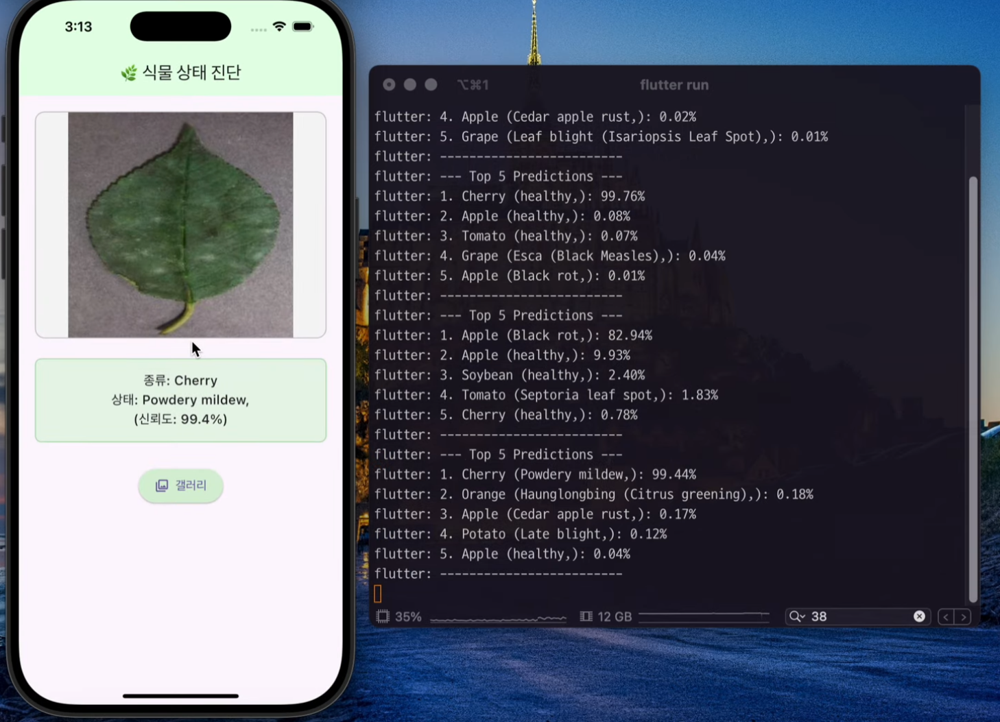


## MVP 서비스 와이어 프레임 

- 플랜트닥터는 도시 원예사들을 위한 AI 기반 식물 건강 관리 앱으로, 기술적 정확성과 사용자 경험을 균형 있게 고려하여 개발
- 특히 AI 모델의 한계를 이해하고 이를 보완하는 방향으로 서비스 기획

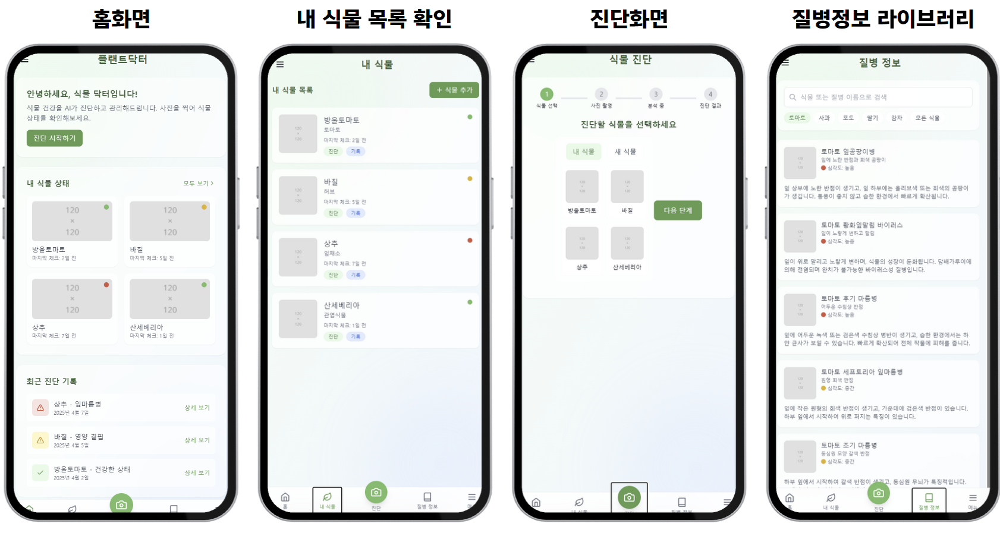
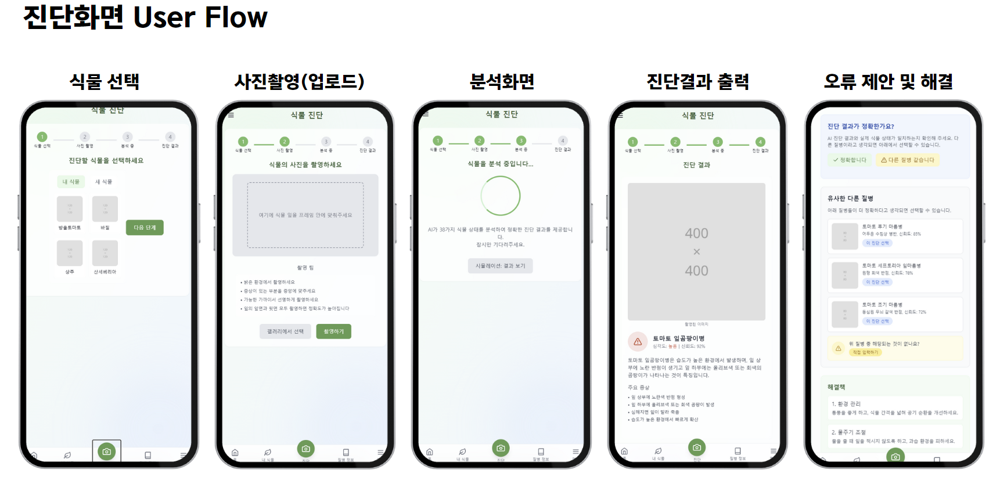

### MVP 서비스 프로토타입 (동작시연)
- https://claude.site/artifacts/bbf86abb-c758-404b-9c75-20c87d4621ac

### 1. 다단계 진단 시스템
현재 UI 프로토타입에 구현된 4단계 진단 프로세스는 AI 모델의 한계를 보완하기 위한 설계입니다:

- 단계 1 - 식물 선택: 종류를 미리 선택하여 분류 범위를 좁힘으로써 정확도 향상
- 단계 2 - 가이드 촬영: 최적의 진단을 위한 촬영 방법 안내
- 단계 3 - 분석 및 필터링: AI 분석 과정에서 Outlier Detection 적용
- 단계 4 - 결과 확인 및 사용자 검증: AI 진단 결과를 사용자가 검토하고 필요시 수정

### 2. 사용자 검증 메커니즘
진단 결과 화면에 구현된 사용자 검증 기능은 AI 모델의 오분류 가능성을 줄이기 위한 핵심 요소입니다:

- 진단 결과 정확도 피드백: "진단 결과가 정확한가요?" 섹션으로 사용자 확인
- 대안 질병 제시: 유사 질병 목록을 제공하여 사용자가 비교 판단 가능
- 직접 입력 옵션: 제시된 옵션 외에도 사용자의 판단을 반영할 기회 제공

### 3. 투명한 신뢰도 표시
진단 결과에 신뢰도 점수(92%)와 심각도 정보를 명시적으로 표시하여:

- 사용자가 AI 판단의 확실성을 이해할 수 있도록 함
- 낮은 신뢰도 경우 더 신중한 판단을 유도

# 향후 개선 방향

### 모델 경량화:

- MobileNet, EfficientNet 등 더 가벼운 모델로 전이학습 시도
- 모델 양자화를 통한 추론 속도 개선
- 스마트폰에서의 실시간 진단을 위한 최적화

### 데이터 전처리 및 개선:

- 데이터셋 불균형 문제 해결: 클래스 간 데이터 수 불균형이 심각하여 과대표현/과소표현된 클래스에 대한 성능 편차 발생. 언더샘플링, 오버샘플링, 가중치 조정 등의 기법 적용 필요
- 현실 환경 대응력 향상: 현재 데이터셋의 이미지가 너무 잘 정제되어 있어 실제 일반인이 촬영한 다양한 조명, 각도, 배경의 이미지에 대응하지 못함. 다양한 증강 기법 적용 필요
- 실내 조명 환경, 베란다 환경 등 도시 환경에서 촬영된 이미지 추가 확보
- 아파트 베란다, 실내 화분 등 도시 원예 환경에 특화된 데이터 확보

### 아키텍처 개선:
- 2단계 분류 시스템 도입 (식물 종류 식별 → 질병 진단)
- 앙상블 기법을 통한 정확도 향상
- 시간에 따른 식물 변화를 추적할 수 있는 시계열 분석 모델 추가
- 비식물 이미지 필터링: 현재 모델은 사람이나 기타 관련 없는 사진을 넣었을 때 제대로 인식하지 못함. 식물/비식물 이미지를 구분하는 전처리 분류기 추가 필요
- 예외 처리 강화: 모바일 경량화 모델 재훈련 시 적절한 예외 처리 및 신뢰도 임계값 설정 필요

### 사용자 경험 최적화:
- 진단 결과에 신뢰도 점수를 함께 제공하여 사용자에게 참고 정보 제공
- 낮은 신뢰도 예측에 대한 대체 진단 옵션 제시
- 지역별 기후 데이터와 연동하여 맞춤형 관리 조언 제공
- 진단 후 식물 상태 개선을 위한 단계별 가이드 추가

## 요약

- 본 프로젝트는 COVID-19 이후 급증한 홈가드닝 트렌드와 도시 농업 관심에 부응하여, 아파트 베란다, 실내 공간, 옥상 정원 등에서 식물을 기르는 도시 원예사를 위한 **AI 기반 식물 건강 관리 앱 '플랜트닥터'** 의 핵심 기능인 식물 질병 진단 모델을 개발. 
- **Plant Village 데이터셋을 활용하여 38가지 식물 상태를 분류할 수 있는 기본 CNN 모델과 VGG16 기반 전이학습 모델을 구축하고 성능을 비교*

- 기본 CNN 모델은 약 94%의 최대 검증 정확도를 보였으나 과적합 문제가 뚜렷했으며, VGG16 기반 전이학습 모델은 약 92%의 검증 정확도를 보이면서 과적합이 현저히 감소
- 결론: **모바일 애플리케이션에 적합한 안정성과 효율성을 고려할 때 전이학습 모델이 더 적합**하다고 판단

- 이 기술을 통해 **원예 전문 지식이 없는 일반 도시 거주자들도 식물 건강 문제를 조기에 식별하고 적절히 대응**할 수 있게 됨으로써, 사용자들의 식물 재배 성공률을 높이고 지속 가능한 도시 농업 활동을 지원할 수 있을 것으로 기대
- **향후 모델 경량화, 데이터 개선, 아키텍처 개선을 통해 성능과 효율성을 더욱 향상시킬 예정**